In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Import Libraries

In [ ]:
%%capture
import os
import cv2
import glob
import natsort
import datetime
import numpy as np
import pandas as pd
import tensorflow as tf
import albumentations as A

now = datetime.datetime.now
import matplotlib.pyplot as plt
%matplotlib inline

from tqdm import tqdm
from sklearn.model_selection import KFold
from sklearn.metrics import roc_curve, roc_auc_score, confusion_matrix 

import tensorflow.keras.backend as K
from tensorflow.data import AUTOTUNE
from tensorflow.keras import preprocessing
from tensorflow.keras.models import Model
from tensorflow.keras.backend import epsilon
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import Input, concatenate, Conv2D, MaxPooling2D, Activation, UpSampling2D, BatchNormalization,Cropping2D, \
 add, Conv2DTranspose, multiply, Lambda, AveragePooling2D, average, UpSampling2D, Dropout, Concatenate, MaxPool2D, Flatten, Reshape, SpatialDropout2D
from tensorflow.keras.initializers import glorot_normal, random_normal, random_uniform

In [ ]:
%%capture
!pip install keras-unet-collection
import keras_unet_collection as kuc
from keras_unet_collection import models
from keras_unet_collection import losses

## Load Data

In [ ]:
IMG_SIZE = 256
pth1 = glob.glob("drive/MyDrive/UNET-Data/Transversal/*")
pth2 = glob.glob("drive/MyDrive/UNET-Data/Transversal-Mask/*")

img_paths = np.random.RandomState(seed=42).permutation(natsort.natsorted(pth1))
mask_paths = np.random.RandomState(seed=42).permutation(natsort.natsorted(pth2))
print('Total images in the dataset:', len(img_paths))
print(list(zip(img_paths, mask_paths)))

Total images in the dataset: 530
[('drive/MyDrive/UNET-Data/Transversal/Image_4_Transversal_102.png', 'drive/MyDrive/UNET-Data/Transversal-Mask/Mask_4_Transversal_102.png'), ('drive/MyDrive/UNET-Data/Transversal/Image_11_Transversal_106.png', 'drive/MyDrive/UNET-Data/Transversal-Mask/Mask_11_Transversal_106.png'), ('drive/MyDrive/UNET-Data/Transversal/Image_1_Transversal_69.png', 'drive/MyDrive/UNET-Data/Transversal-Mask/Mask_1_Transversal_69.png'), ('drive/MyDrive/UNET-Data/Transversal/Image_9_Transversal_124.png', 'drive/MyDrive/UNET-Data/Transversal-Mask/Mask_9_Transversal_124.png'), ('drive/MyDrive/UNET-Data/Transversal/Image_8_Transversal_142.png', 'drive/MyDrive/UNET-Data/Transversal-Mask/Mask_8_Transversal_142.png'), ('drive/MyDrive/UNET-Data/Transversal/Image_3_Transversal_63.png', 'drive/MyDrive/UNET-Data/Transversal-Mask/Mask_3_Transversal_63.png'), ('drive/MyDrive/UNET-Data/Transversal/Image_6_Transversal_110.png', 'drive/MyDrive/UNET-Data/Transversal-Mask/Mask_6_Transversal

In [ ]:
transform = A.Compose([

    A.HorizontalFlip(p=0.8),
    A.VerticalFlip(p=0.8),
    A.RandomRotate90(p=0.8),
    A.Transpose(p=0.8),

    #A.RandomSizedCrop(min_max_height=(100, 200), height=256, width=256, p=0.5),
    #A.RandomBrightnessContrast(brightness_limit=0.1, p=0.5),    
])


def album_transform(x, y):
  transformed_imgs = transform(image=x, mask=y)
  img_aug, mask_aug = transformed_imgs['image'], transformed_imgs['mask'] 
  return img_aug, mask_aug 

def load_aug_arrs(x,y,bs, preproc=None):
  if preproc:
    x = preproc(x)
  train_ds = tf.data.Dataset.from_tensor_slices((x, y))
  train_ds = train_ds.map(lambda a,b : tf.numpy_function(album_transform, [a,b], (tf.float32,tf.float32)), num_parallel_calls=AUTOTUNE, deterministic=True)
  train_ds = train_ds.shuffle(64).batch(bs).prefetch(AUTOTUNE)
  return train_ds

def load_arr_datastet(img_list, mask_list):
  images, masks = [], []
  for i in tqdm(zip(img_list, mask_list)):
    x = preprocessing.image.load_img(i[0], color_mode='rgb', target_size=(IMG_SIZE,IMG_SIZE))
    x = (preprocessing.image.img_to_array(x))/255.0
    y = preprocessing.image.load_img(i[1], color_mode='grayscale', target_size=(IMG_SIZE,IMG_SIZE))
    y = (preprocessing.image.img_to_array(y))/255.0
    images.append(x)
    masks.append(y)

  arr_imgs = np.array(images)
  arr_masks = np.array(masks)
  return arr_imgs, arr_masks

## Data Visualization

530it [02:37,  3.37it/s]


float32 (530, 256, 256, 3) 1.0 float32 (530, 256, 256, 1) 1.0

 drive/MyDrive/UNET-Data/Transversal/Image_4_Transversal_102.png drive/MyDrive/UNET-Data/Transversal-Mask/Mask_4_Transversal_102.png


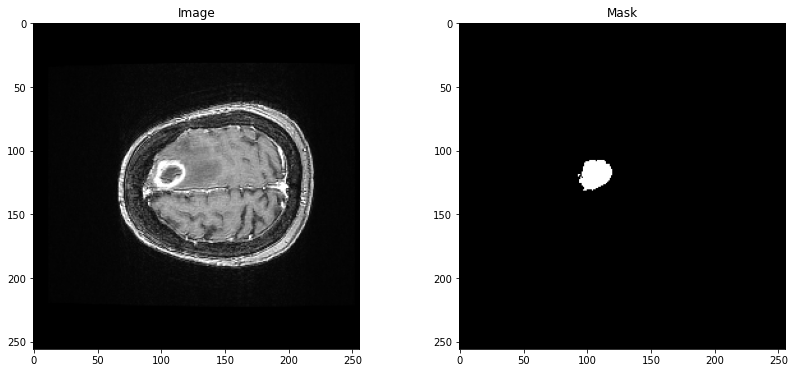


 drive/MyDrive/UNET-Data/Transversal/Image_11_Transversal_106.png drive/MyDrive/UNET-Data/Transversal-Mask/Mask_11_Transversal_106.png


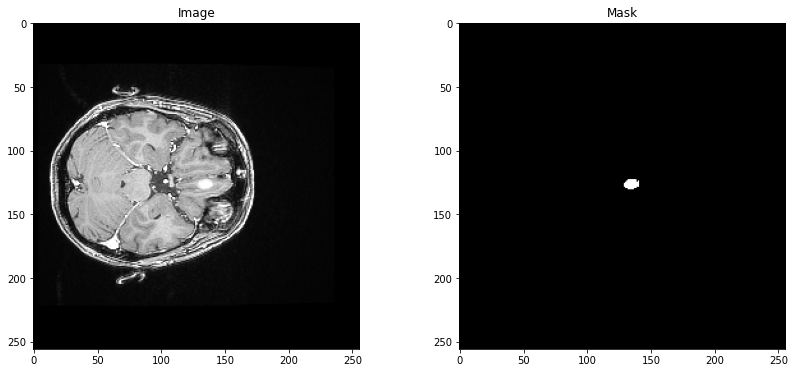


 drive/MyDrive/UNET-Data/Transversal/Image_1_Transversal_69.png drive/MyDrive/UNET-Data/Transversal-Mask/Mask_1_Transversal_69.png


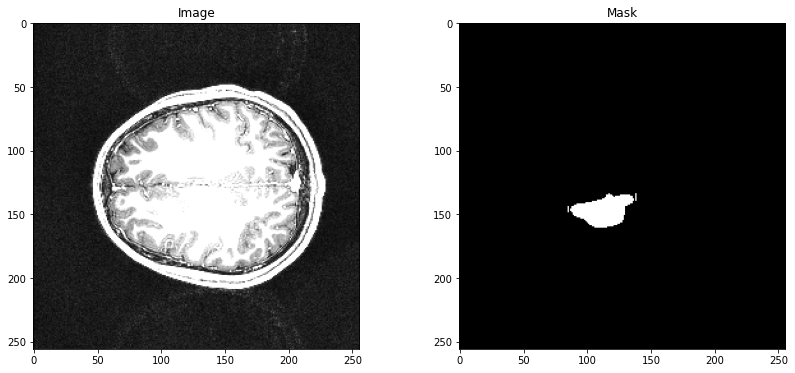


 drive/MyDrive/UNET-Data/Transversal/Image_9_Transversal_124.png drive/MyDrive/UNET-Data/Transversal-Mask/Mask_9_Transversal_124.png


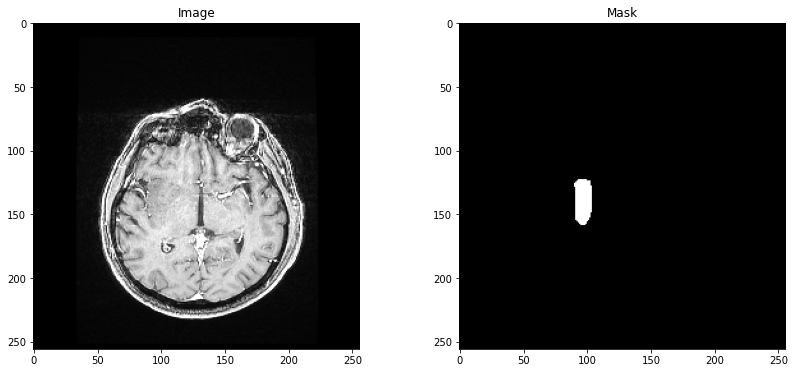


 drive/MyDrive/UNET-Data/Transversal/Image_8_Transversal_142.png drive/MyDrive/UNET-Data/Transversal-Mask/Mask_8_Transversal_142.png


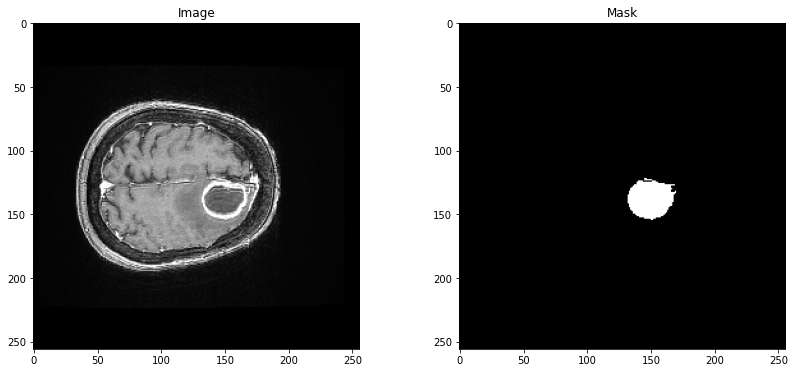


 drive/MyDrive/UNET-Data/Transversal/Image_3_Transversal_63.png drive/MyDrive/UNET-Data/Transversal-Mask/Mask_3_Transversal_63.png


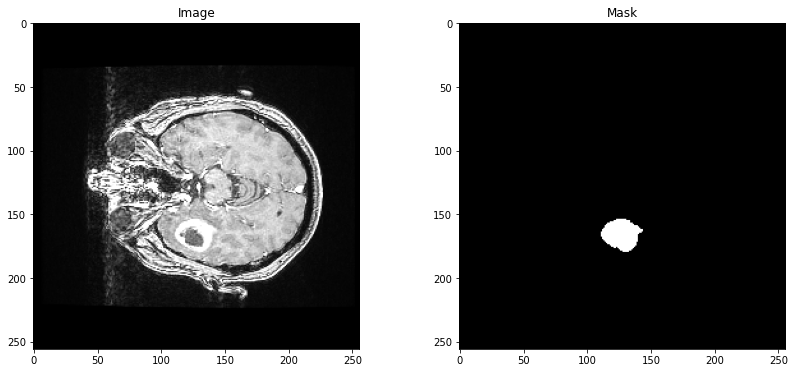


 drive/MyDrive/UNET-Data/Transversal/Image_6_Transversal_110.png drive/MyDrive/UNET-Data/Transversal-Mask/Mask_6_Transversal_110.png


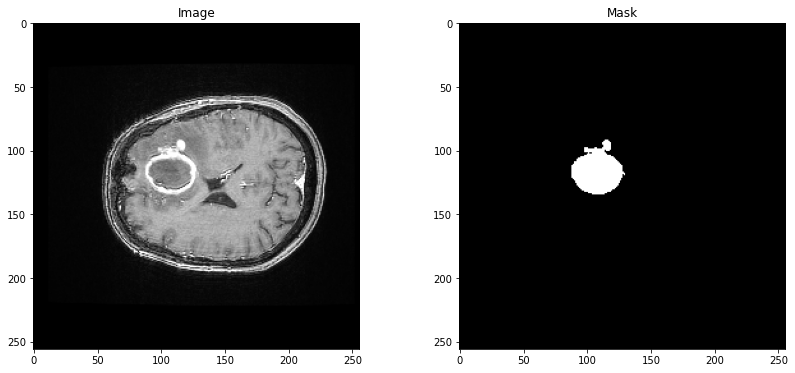


 drive/MyDrive/UNET-Data/Transversal/Image_14_Transversal_52.png drive/MyDrive/UNET-Data/Transversal-Mask/Mask_14_Transversal_52.png


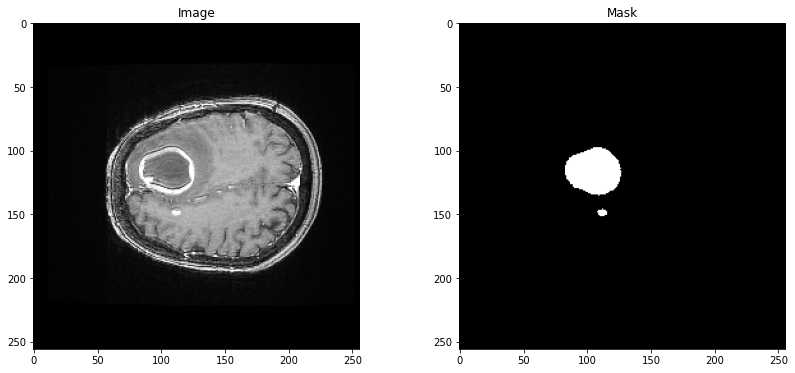


 drive/MyDrive/UNET-Data/Transversal/Image_14_Transversal_79.png drive/MyDrive/UNET-Data/Transversal-Mask/Mask_14_Transversal_79.png


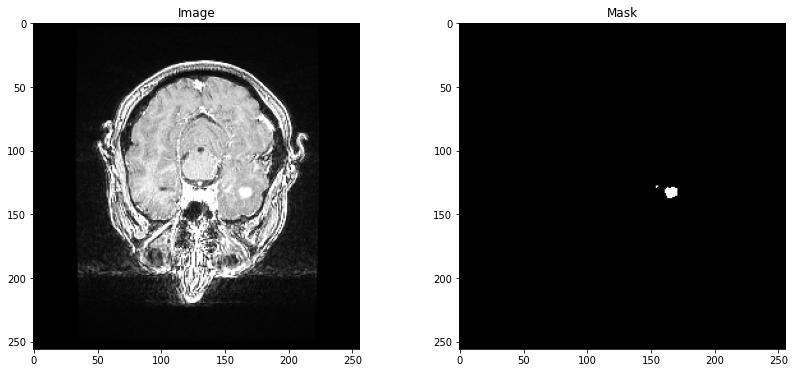


 drive/MyDrive/UNET-Data/Transversal/Image_3_Transversal_82.png drive/MyDrive/UNET-Data/Transversal-Mask/Mask_3_Transversal_82.png


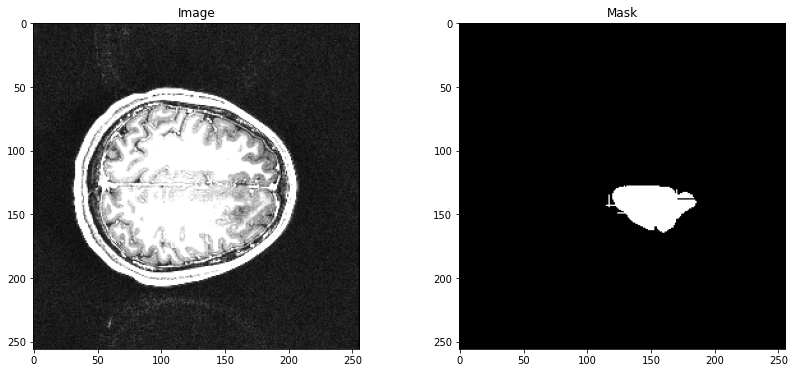

In [ ]:
def plot_ds(img_paths, mask_paths, num_plots=10):
  a,b = load_arr_datastet(img_paths, mask_paths)
  print(a.dtype, a.shape, a.max(), b.dtype, b.shape, b.max())
  c,d = list(load_aug_arrs(a,b,num_plots))[0]
  
  for i in range(num_plots):
    print('\n',img_paths[i], mask_paths[i])
    plt.figure(figsize = (14,6))
    plt.subplot(121)
    plt.title('Image')
    plt.imshow(c[i,:,:,0], cmap='gray')
    plt.subplot(122)
    plt.title('Mask')
    plt.imshow(d[i,:,:,0], cmap='gray')
    plt.show()

plot_ds(img_paths, mask_paths)

## Losses and Performance Metrics

In [1]:
# Dice score coefficient and Dice loss 
def dsc(y_true, y_pred):
    smooth = 1.
    #y_true = y_true[...,:1]
    #y_pred = y_pred[...,:1]
    bs = tf.shape(y_true)[0]
    yt = tf.reshape(y_true, [bs,-1])
    yp = tf.reshape(y_pred, [bs,-1])
    intersection = tf.math.reduce_sum(yt * yp, axis=-1)
    denom = (tf.math.reduce_sum(yt, axis=-1) + tf.math.reduce_sum(yp, axis=-1) + smooth) 
    score = (2 * intersection + smooth) / denom
    score = tf.math.reduce_mean(score)
    return score

def dice_loss(y_true, y_pred):
    y_true = y_true[...,:1]
    y_pred = y_pred[...,:1]
    loss = 1 - dsc(y_true, y_pred)
    return loss
    
# Performance metrics: Dice score coefficient, IOU, recall, sensitivity
def perf_metrics(y_true, y_pred):
    y_pred_pos = np.round(np.clip(y_pred, 0, 1))
    y_pred_neg = 1 - y_pred_pos
    y_pos = np.round(np.clip(y_true, 0, 1)) # ground truth
    y_neg = 1 - y_pos
    tp = np.sum(y_pos * y_pred_pos)
    tn = np.sum(y_neg * y_pred_neg)
    fp = np.sum(y_neg * y_pred_pos)
    fn = np.sum(y_pos * y_pred_neg)
    tpr = (tp + K.epsilon()) / (tp + fn + K.epsilon()) #recall
    tnr = (tn + K.epsilon()) / (tn + fp + K.epsilon())
    prec = (tp + K.epsilon()) / (tp + fp + K.epsilon()) #precision
    iou = (tp + K.epsilon()) / (tp + fn + fp + K.epsilon()) #intersection over union
    dsc = (2*tp + K.epsilon()) / (2*tp + fn + fp + K.epsilon()) #dice score
    return [dsc, iou, tpr, prec]

## LinkNet Model

In [ ]:
# Import the required libraries.
from tensorflow.keras.layers import (
        Activation,
        Conv2D,
        Conv2DTranspose,
        Input,
        BatchNormalization,
        Add,
        MaxPool2D
)
from tensorflow.keras.models import Model


# n
encoder_output_maps = {
    'block_1': 64,
    'block_2': 128,
    'block_3': 256,
    'block_4': 512
}
decoder_output_maps = {
    'block_1': 64,
    'block_2': 64,
    'block_3': 128,
    'block_4': 256
}

# m
encoder_input_maps = {
    'block_1': 64,
    'block_2': 64,
    'block_3': 128,
    'block_4': 256
}
decoder_input_maps = {
    'block_1': 64,
    'block_2': 128,
    'block_3': 256,
    'block_4': 512
}


# Function to create the LinkNet architecture.
def LinkNet(img_height, img_width, nclasses=None):

    def encoder_block(input_tensor, block=None):
        block_name = f'block_{block}'
        nfilters = encoder_output_maps[block_name]

        input_tensor_projection = Conv2D(
                filters=nfilters,
                kernel_size=(1, 1),
                strides=(2, 2),
                padding='same',
                kernel_initializer='he_normal',
                name=f'{block_name}_conv2d_1x1'
        )(input_tensor)
        input_tensor_projection = BatchNormalization(
                name=f'{block_name}_bn_1x1'
        )(input_tensor_projection)
        input_tensor_projection = Activation(
                'relu',
                name=f'{block_name}_relu_1x1'
        )(input_tensor_projection)

        x = Conv2D(
                filters=nfilters,
                kernel_size=(3, 3),
                strides=(2, 2),
                padding='same',
                kernel_initializer='he_normal',
                name=f'encoder_{block_name}_conv2d_1'
        )(input_tensor)
        x = BatchNormalization(name=f'encoder_{block_name}_bn_1')(x)
        x = Activation('relu', name=f'encoder_{block_name}_relu_1')(x)
        x = Conv2D(
                filters=nfilters,
                kernel_size=(3, 3),
                strides=(1, 1),
                padding='same',
                kernel_initializer='he_normal',
                name=f'encoder_{block_name}_conv2d_2'
        )(x)
        x = BatchNormalization(name=f'encoder_{block_name}_bn_2')(x)
        x = Add(
            name=f'encoder_{block_name}_add_1'
        )([x, input_tensor_projection])
        x = Activation('relu', name=f'encoder_{block_name}_relu_2')(x)
        x_res = x

        x = Conv2D(
                filters=nfilters,
                kernel_size=(3, 3),
                strides=(1, 1),
                padding='same',
                kernel_initializer='he_normal',
                name=f'encoder_{block_name}_conv2d_3'
        )(x_res)
        x = BatchNormalization(name=f'encoder_{block_name}_bn_3')(x)
        x = Activation('relu', name=f'encoder_{block_name}_relu_3')(x)
        x = Conv2D(
                filters=nfilters,
                kernel_size=(3, 3),
                strides=(1, 1),
                padding='same',
                kernel_initializer='he_normal',
                name=f'encoder_{block_name}_conv2d_4'
        )(x)
        x = BatchNormalization(name=f'encoder_{block_name}_bn_4')(x)
        x = Add(name=f'encoder_{block_name}_add_2')([x, x_res])
        x = Activation('relu', name=f'encoder_{block_name}_relu_4')(x)
        return x

    def decoder_block(input_tensor, block=None):
        block_name = f'block_{block}'
        nfilters_b = decoder_output_maps[block_name]
        nfilters_a = decoder_input_maps[block_name] // 4

        x = Conv2D(
                filters=nfilters_a,
                kernel_size=(1, 1),
                strides=(1, 1),
                padding='same',
                kernel_initializer='he_normal',
                name=f'decoder_{block_name}_conv2d_1x1'
        )(input_tensor)
        x = BatchNormalization(name=f'decoder_{block_name}_bn_1')(x)
        x = Activation('relu', name=f'decoder_{block_name}_relu_1')(x)
        x = Conv2DTranspose(
                filters=nfilters_a,
                kernel_size=(3, 3),
                strides=(2, 2),
                padding='same',
                kernel_initializer='he_normal',
                name=f'decoder_{block_name}_conv2dT_1'
        )(x)
        x = BatchNormalization(name=f'decoder_{block_name}_bn_2')(x)
        x = Activation('relu', name=f'decoder_{block_name}_relu_2')(x)
        x = Conv2D(
                filters=nfilters_b,
                kernel_size=(1, 1),
                strides=(1, 1),
                padding='same',
                kernel_initializer='he_normal',
                name=f'decoder_{block_name}_conv2d_1x2'
        )(x)
        x = BatchNormalization(name=f'decoder_{block_name}_bn_3')(x)
        x = Activation('relu', name=f'decoder_{block_name}_relu_3')(x)
        return x

    input_layer = Input(shape=(img_height, img_width, 3), name='image_input')
    y = Conv2D(
            filters=64,
            kernel_size=(7, 7),
            strides=(2, 2),
            padding='same',
            kernel_initializer='he_normal',
            name='initial_conv2d'
    )(input_layer)
    y = BatchNormalization(name='initial_block_bn')(y)
    y = Activation('relu', name='initial_block_relu')(y)
    y = MaxPool2D(pool_size=(2, 2), padding='same',
                  name='initial_block_maxpool')(y)
    encoder_outputs = [None]
    for i in range(1, 5):
        y = encoder_block(input_tensor=y, block=i)
        encoder_outputs.append(y)
    for i in range(4, 1, -1):
        y = decoder_block(input_tensor=y, block=i)
        y = Add()([y, encoder_outputs[i - 1]])
    y = decoder_block(input_tensor=y, block=1)

    y = Conv2DTranspose(
            filters=32,
            kernel_size=(3, 3),
            strides=(2, 2),
            padding='same',
            kernel_initializer='he_normal',
            name='final_conv2dT'
    )(y)
    y = BatchNormalization(name='final_block_bn_1')(y)
    y = Activation('relu', name='final_block_relu_1')(y)
    y = Conv2D(
            filters=32,
            kernel_size=(3, 3),
            strides=(1, 1),
            padding='same',
            kernel_initializer='he_normal',
            name='final_conv2d'
    )(y)
    y = BatchNormalization(name='final_block_bn_2')(y)
    y = Activation('relu', name='final_block_relu_2')(y)
    y = Conv2DTranspose(
            filters=nclasses,
            kernel_size=(2, 2),
            strides=(2, 2),
            padding='same',
            kernel_initializer='he_normal',
            name='output_conv2dT'
    )(y)
    output_layer = Activation('sigmoid', name='predictions')(y)

    model = Model(inputs=input_layer, outputs=output_layer, name='LinkNet')
    return model

In [ ]:
# Evaluate the models using using k-fold cross-validation
LR = 0.0001
n_folds = 5
EPOCHS = 100
PATIENCE = 20
BATCH_SIZE = 8

## Cross Validation

In [ ]:
def train_model(save_pth=None, epochs=EPOCHS, batch_size=BATCH_SIZE, lr=LR, metric_name = 'dice_coef', imgs_pths=img_paths, mask_pths=mask_paths, n_folds=n_folds, patience=PATIENCE):

    numepochs = np.zeros(n_folds,)
    dice_score = np.zeros(n_folds,)
    iou_score = np.zeros_like(dice_score)
    rec_score = np.zeros_like(dice_score)
    prec_score = np.zeros_like(dice_score)
    globacc_score = np.zeros_like(dice_score)
    auc_roc_score = np.zeros_like(dice_score)
    
    kfold = KFold(n_folds, shuffle=False)
    imgs, masks = load_arr_datastet(imgs_pths, mask_pths)

    run = 0;
    # enumerate splits
    print("Intializing Cross Validation")
    for train_ix, test_ix in kfold.split(imgs):
        
        # Display the run number
        print('\nRun #', run+1)
        # Split into train and test sets
        imgs_train, masks_train, imgs_test, masks_test = imgs[train_ix], masks[train_ix], imgs[test_ix], masks[test_ix]
        train_ds = load_aug_arrs(imgs_train, masks_train, batch_size)

        # Compile and fit the  model
        model = LinkNet(256,256,1)
        #model = models.att_unet_2d((IMG_SIZE, IMG_SIZE, 3), [64, 128, 256, 512], n_labels=1,
        #                           stack_num_down=2, stack_num_up=2,
        #                           activation='ReLU', atten_activation='ReLU', attention='add', output_activation='Sigmoid', 
        #                           batch_norm=True, pool='max', unpool='nearest', name='attunet')
        
        #model = models.unet_2d((256, 256, 3), [64, 128, 256, 512, 1024], n_labels=1,
        #                   stack_num_down=2, stack_num_up=1,
        #                   activation='ReLU', output_activation='Sigmoid', 
        #                   batch_norm=True, pool='max', unpool='nearest', name='unet')
        
        optim = Adam(learning_rate = lr) 
        model.compile(optimizer = optim, loss=losses.dice, metrics = [dsc, losses.dice_coef])
        
        t = now()
        callbacks = [EarlyStopping(monitor='val_loss', verbose=10, restore_best_weights=True, patience=patience)]
        history = model.fit(train_ds, validation_data=(imgs_test, masks_test), validation_batch_size=batch_size, epochs=epochs, callbacks=callbacks)
        print('Training time: %s' % (now() - t))

        # Plot the loss and accuracy
        train_loss = history.history['loss']
        val_loss = history.history['val_loss']
        acc = history.history[metric_name] 
        val_acc = history.history[f'val_{metric_name}']

        epochsn = np.arange(1, len(train_loss)+1,1)
        plt.figure(figsize = (12,5))
        plt.subplot(121)
        plt.plot(epochsn,train_loss, 'b', label='Training Loss')
        plt.plot(epochsn,val_loss, 'r', label='Validation Loss')
        plt.grid(color='gray', linestyle='--')
        plt.legend()
        plt.title('LOSS, Epochs={}, Batch Size={}'.format(EPOCHS, batch_size))
        plt.xlabel('Epochs')
        plt.ylabel('Loss')

        plt.subplot(122)
        plt.plot(epochsn, acc, 'b', label='Training Dice Coefficient')
        plt.plot(epochsn, val_acc, 'r', label='Validation Dice Coefficient')
        plt.grid(color='gray', linestyle='--')
        plt.legend()            
        plt.title('DSC, Epochs={}, Batch Size={}'.format(EPOCHS, batch_size))
        plt.xlabel('Epochs')
        plt.ylabel('DSC')
        plt.show()
        
        # Make predictions
        t = now()
        preds = model.predict(imgs_test)
        print('Testing time: %s' % (now() - t))
        
        if save_pth:
          print('Saving validation-fold predictions....')
          for pred_sample, test_ix_sample in zip(preds, test_ix):
            save_img_pth = os.path.join(save_pth, os.path.splitext(os.path.basename(mask_paths[test_ix_sample]))[0] +'_UNET.png')
            save_img = (pred_sample*255).astype(np.uint8)
            cv2.imwrite(save_img_pth, save_img)

        # Evaluate model
        num_test = len(imgs_test)
        # Calculate performance metrics
        dsc_sc = np.zeros((num_test,1))
        iou_sc = np.zeros_like(dsc_sc)
        rec_sc = np.zeros_like(dsc_sc)
        prec_sc = np.zeros_like(dsc_sc)
        thresh = 0.5
        for i in range(num_test):
            dsc_sc[i], iou_sc[i], rec_sc[i], prec_sc[i] = perf_metrics(masks_test[i], preds[i] > thresh)

        print('-'*30)
        print('USING THRESHOLD', thresh)
        print('\n DSC \t\t{0:^.3f} \n IOU \t\t{1:^.3f} \n Recall \t{2:^.3f} \n Precision\t{3:^.3f}'.format(
                np.sum(dsc_sc)/num_test,  
                np.sum(iou_sc)/num_test,  
                np.sum(rec_sc)/num_test,
                np.sum(prec_sc)/num_test ))

        # Confusion matrix
        confusion = confusion_matrix(masks_test.ravel().astype(np.int64),(preds.ravel()>thresh).astype(np.int64))
        accuracy = float(confusion[0,0]+confusion[1,1])/float(np.sum(confusion))
        print(' Global Acc \t{0:^.3f}'.format(accuracy))
        
        try:
          # Area under the ROC curve
          AUC_ROC = roc_auc_score(preds.ravel()>thresh, masks_test.ravel())
          print(' AUC ROC \t{0:^.3f}'.format(AUC_ROC))
        except:
          AUC_ROC = 0
          print('AUC ROC \tOnly one class present in y_true. ROC AUC score is not defined in that case.')
        
        # To plot a set of images with predicted masks uncomment these lines
        num_disp = 10
        j=1
        plt.figure(figsize = (14,num_disp*3))
        for i in range(num_disp):
            plt.subplot(num_disp,4,j)
            plt.axis('off')
            plt.imshow(np.squeeze(imgs_test[i]), cmap='gray')
            plt.title('Image')
            j +=1
            plt.subplot(num_disp,4,j)
            plt.axis('off')
            plt.imshow(np.squeeze(masks_test[i]),cmap='gray')
            plt.title('Mask')
            j +=1
            plt.subplot(num_disp,4,j)
            plt.axis('off')
            plt.imshow(np.squeeze(preds[i]))
            plt.title('Prediction')
            j +=1
            plt.subplot(num_disp,4,j)
            plt.axis('off')
            plt.imshow(np.squeeze(np.round(preds[i])), cmap='gray')
            plt.title('Rounded; IOU=%0.2f, Rec=%0.2f, Prec=%0.2f' %(iou_sc[i], rec_sc[i], prec_sc[i]))
            j +=1
        plt.tight_layout()
        plt.show()    
        print('*'*60)
        
        # Save outputs 
        numepochs[run] = epochsn[-1]
        dice_score[run] = np.sum(dsc_sc)/num_test
        iou_score[run] = np.sum(iou_sc)/num_test
        rec_score[run] = np.sum(rec_sc)/num_test
        prec_score[run] = np.sum(prec_sc)/num_test
        globacc_score[run] = accuracy
        auc_roc_score[run] = AUC_ROC
        run +=1
    
    df = pd.DataFrame({'Epochs Number': numepochs, 'Dice Score': dice_score, 'IOU Score': iou_score, 'Recall (Sensitivity)': rec_score,
                'Precision': prec_score, 'Global Accuracy': globacc_score, 'AUC-ROC': auc_roc_score})

    return df

# U-Net

## Sagittal

162it [00:00, 228.06it/s]


Intializing Cross Validation

Run # 1
Epoch 1/100
17/17 [==============================] - 14s 721ms/step - loss: 0.9370 - dice_coef: 0.0618 - val_loss: 0.9756 - val_dice_coef: 0.0204
Epoch 2/100
17/17 [==============================] - 10s 572ms/step - loss: 0.8944 - dice_coef: 0.1008 - val_loss: 0.9748 - val_dice_coef: 0.0211
Epoch 3/100
17/17 [==============================] - 10s 573ms/step - loss: 0.8622 - dice_coef: 0.1308 - val_loss: 0.9768 - val_dice_coef: 0.0194
Epoch 4/100
17/17 [==============================] - 9s 543ms/step - loss: 0.8257 - dice_coef: 0.1659 - val_loss: 0.9852 - val_dice_coef: 0.0123
Epoch 5/100
17/17 [==============================] - 10s 581ms/step - loss: 0.8058 - dice_coef: 0.1850 - val_loss: 0.9893 - val_dice_coef: 0.0090
Epoch 6/100
17/17 [==============================] - 9s 548ms/step - loss: 0.7870 - dice_coef: 0.2022 - val_loss: 0.9711 - val_dice_coef: 0.0242
Epoch 7/100
17/17 [==============================] - 9s 542ms/step - loss: 0.7634 - dice

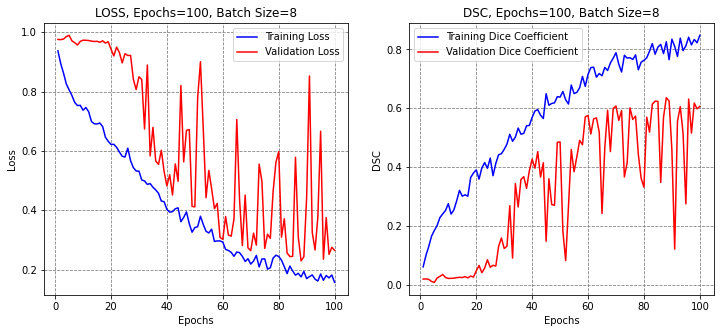

Testing time: 0:00:00.947332
Saving validation-fold predictions....
------------------------------
USING THRESHOLD 0.5

 DSC 		0.611 
 IOU 		0.510 
 Recall 	0.714 
 Precision	0.683
 Global Acc 	0.994
 AUC ROC 	0.848


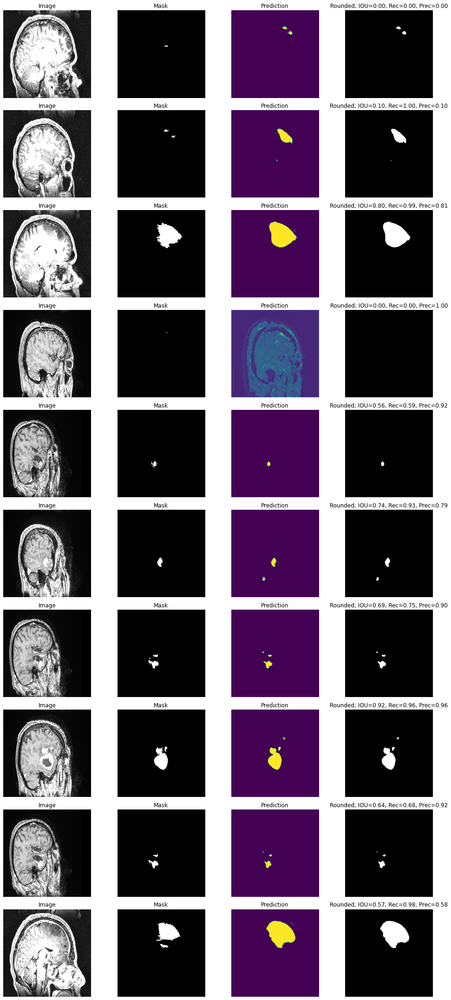

************************************************************

Run # 2
Epoch 1/100
17/17 [==============================] - 13s 608ms/step - loss: 0.9472 - dice_coef: 0.0564 - val_loss: 0.9645 - val_dice_coef: 0.0302
Epoch 2/100
17/17 [==============================] - 9s 541ms/step - loss: 0.9123 - dice_coef: 0.0890 - val_loss: 0.9675 - val_dice_coef: 0.0275
Epoch 3/100
17/17 [==============================] - 9s 548ms/step - loss: 0.8965 - dice_coef: 0.1099 - val_loss: 0.9689 - val_dice_coef: 0.0263
Epoch 4/100
17/17 [==============================] - 10s 586ms/step - loss: 0.8660 - dice_coef: 0.1413 - val_loss: 0.9686 - val_dice_coef: 0.0266
Epoch 5/100
17/17 [==============================] - 9s 546ms/step - loss: 0.8512 - dice_coef: 0.1475 - val_loss: 0.9679 - val_dice_coef: 0.0272
Epoch 6/100
17/17 [==============================] - 9s 540ms/step - loss: 0.8372 - dice_coef: 0.1658 - val_loss: 0.9678 - val_dice_coef: 0.0273
Epoch 7/100
17/17 [==============================] - 10s 5

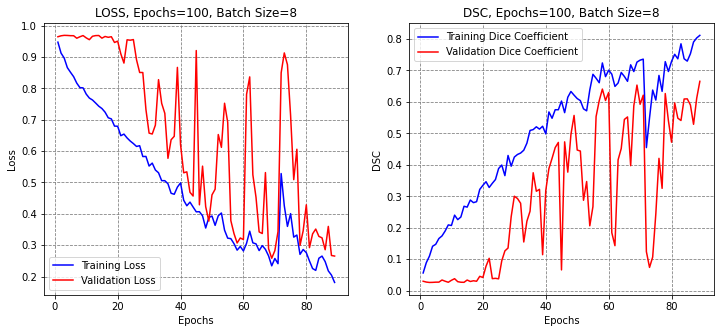

Testing time: 0:00:00.949413
Saving validation-fold predictions....
------------------------------
USING THRESHOLD 0.5

 DSC 		0.599 
 IOU 		0.518 
 Recall 	0.612 
 Precision	0.854
 Global Acc 	0.995
 AUC ROC 	0.909


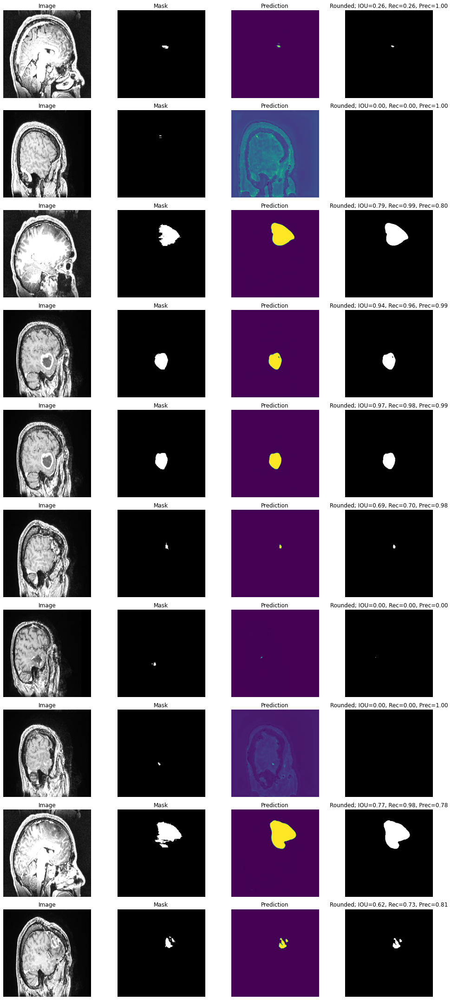

************************************************************

Run # 3
Epoch 1/100
17/17 [==============================] - 15s 758ms/step - loss: 0.9467 - dice_coef: 0.0521 - val_loss: 0.9702 - val_dice_coef: 0.0298
Epoch 2/100
17/17 [==============================] - 9s 546ms/step - loss: 0.9128 - dice_coef: 0.0841 - val_loss: 0.9711 - val_dice_coef: 0.0289
Epoch 3/100
17/17 [==============================] - 9s 549ms/step - loss: 0.8893 - dice_coef: 0.1089 - val_loss: 0.9725 - val_dice_coef: 0.0275
Epoch 4/100
17/17 [==============================] - 9s 550ms/step - loss: 0.8685 - dice_coef: 0.1347 - val_loss: 0.9723 - val_dice_coef: 0.0277
Epoch 5/100
17/17 [==============================] - 9s 544ms/step - loss: 0.8566 - dice_coef: 0.1470 - val_loss: 0.9718 - val_dice_coef: 0.0282
Epoch 6/100
17/17 [==============================] - 9s 539ms/step - loss: 0.8457 - dice_coef: 0.1639 - val_loss: 0.9719 - val_dice_coef: 0.0281
Epoch 7/100
17/17 [==============================] - 9s 539

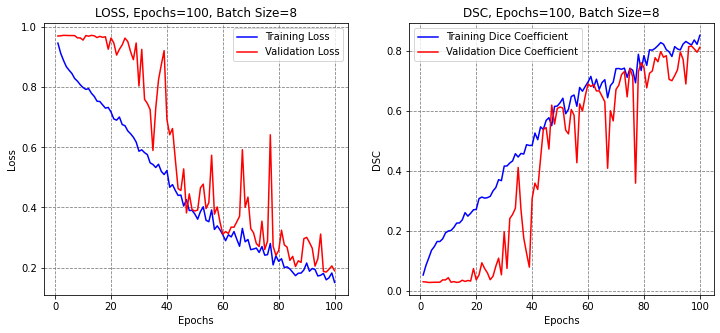

Testing time: 0:00:00.822965
Saving validation-fold predictions....
------------------------------
USING THRESHOLD 0.5

 DSC 		0.527 
 IOU 		0.470 
 Recall 	0.498 
 Precision	0.925
 Global Acc 	0.997
 AUC ROC 	0.968


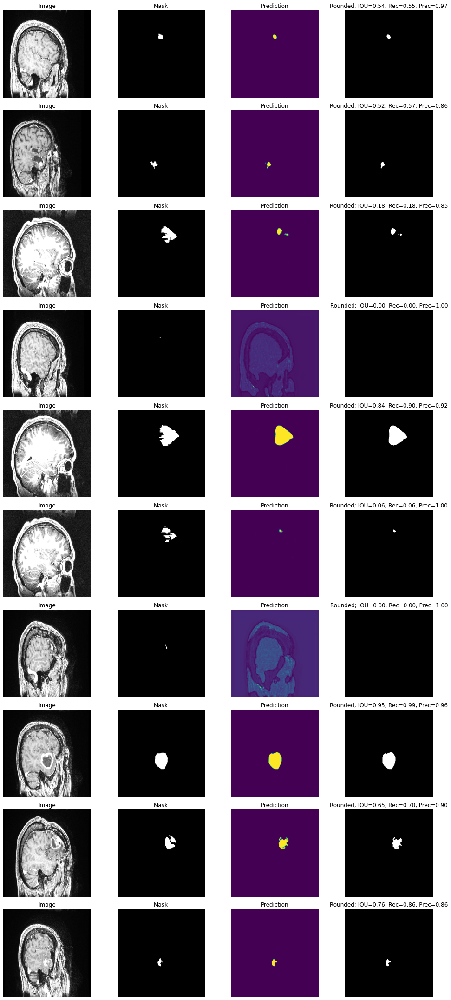

************************************************************

Run # 4
Epoch 1/100
17/17 [==============================] - 12s 576ms/step - loss: 0.9450 - dice_coef: 0.0565 - val_loss: 0.9717 - val_dice_coef: 0.0283
Epoch 2/100
17/17 [==============================] - 9s 544ms/step - loss: 0.9020 - dice_coef: 0.0957 - val_loss: 0.9717 - val_dice_coef: 0.0283
Epoch 3/100
17/17 [==============================] - 9s 549ms/step - loss: 0.8642 - dice_coef: 0.1342 - val_loss: 0.9730 - val_dice_coef: 0.0270
Epoch 4/100
17/17 [==============================] - 9s 546ms/step - loss: 0.8222 - dice_coef: 0.1702 - val_loss: 0.9738 - val_dice_coef: 0.0262
Epoch 5/100
17/17 [==============================] - 9s 550ms/step - loss: 0.8111 - dice_coef: 0.1891 - val_loss: 0.9685 - val_dice_coef: 0.0315
Epoch 6/100
17/17 [==============================] - 9s 546ms/step - loss: 0.7833 - dice_coef: 0.2163 - val_loss: 0.9642 - val_dice_coef: 0.0358
Epoch 7/100
17/17 [==============================] - 9s 545

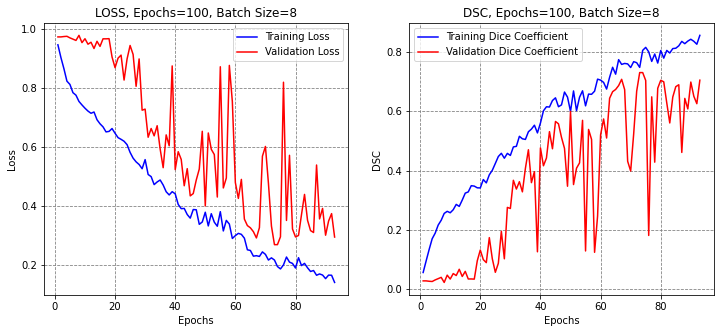

Testing time: 0:00:00.937888
Saving validation-fold predictions....
------------------------------
USING THRESHOLD 0.5

 DSC 		0.639 
 IOU 		0.550 
 Recall 	0.719 
 Precision	0.723
 Global Acc 	0.995
 AUC ROC 	0.888


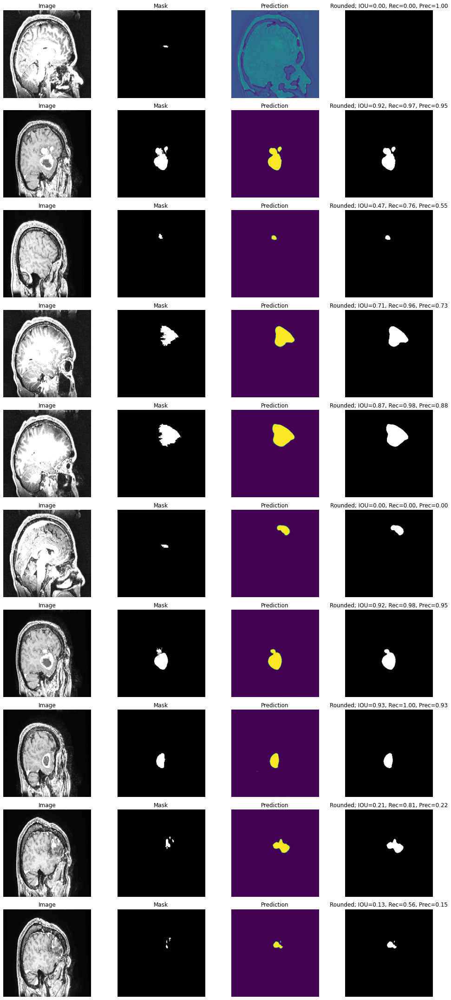

************************************************************

Run # 5
Epoch 1/100
17/17 [==============================] - 12s 576ms/step - loss: 0.9423 - dice_coef: 0.0577 - val_loss: 0.9728 - val_dice_coef: 0.0272
Epoch 2/100
17/17 [==============================] - 9s 546ms/step - loss: 0.9004 - dice_coef: 0.1044 - val_loss: 0.9730 - val_dice_coef: 0.0270
Epoch 3/100
17/17 [==============================] - 9s 548ms/step - loss: 0.8594 - dice_coef: 0.1365 - val_loss: 0.9749 - val_dice_coef: 0.0251
Epoch 4/100
17/17 [==============================] - 10s 584ms/step - loss: 0.8366 - dice_coef: 0.1696 - val_loss: 0.9754 - val_dice_coef: 0.0246
Epoch 5/100
17/17 [==============================] - 10s 586ms/step - loss: 0.8097 - dice_coef: 0.1822 - val_loss: 0.9713 - val_dice_coef: 0.0287
Epoch 6/100
17/17 [==============================] - 9s 542ms/step - loss: 0.7929 - dice_coef: 0.2170 - val_loss: 0.9751 - val_dice_coef: 0.0249
Epoch 7/100
17/17 [==============================] - 9s 5

In [ ]:
outputs_df = train_model('/content/drive/MyDrive/OUTS/Sagittal/')

162it [00:01, 145.97it/s]


Intializing Cross Validation

Run # 1
Skipping run 1

Run # 2
Skipping run 2

Run # 3
Skipping run 3

Run # 4
Skipping run 4

Run # 5
Epoch 1/100
17/17 [==============================] - 28s 1s/step - loss: 0.9371 - dice_coef: 0.0629 - val_loss: 0.9709 - val_dice_coef: 0.0291
Epoch 2/100
17/17 [==============================] - 21s 1s/step - loss: 0.8984 - dice_coef: 0.0975 - val_loss: 0.9739 - val_dice_coef: 0.0261
Epoch 3/100
17/17 [==============================] - 20s 1s/step - loss: 0.8672 - dice_coef: 0.1352 - val_loss: 0.9744 - val_dice_coef: 0.0256
Epoch 4/100
17/17 [==============================] - 21s 1s/step - loss: 0.8524 - dice_coef: 0.1495 - val_loss: 0.9749 - val_dice_coef: 0.0251
Epoch 5/100
17/17 [==============================] - 20s 1s/step - loss: 0.8424 - dice_coef: 0.1522 - val_loss: 0.9752 - val_dice_coef: 0.0248
Epoch 6/100
17/17 [==============================] - 20s 1s/step - loss: 0.8250 - dice_coef: 0.1793 - val_loss: 0.9749 - val_dice_coef: 0.0251
Epoch 7/

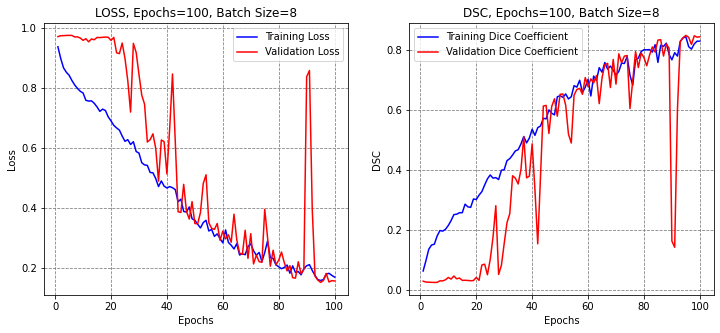

Testing time: 0:00:20.872996
Saving validation-fold predictions....
------------------------------
USING THRESHOLD 0.5

 DSC 		0.528 
 IOU 		0.461 
 Recall 	0.543 
 Precision	0.835
 Global Acc 	0.997
 AUC ROC 	0.958


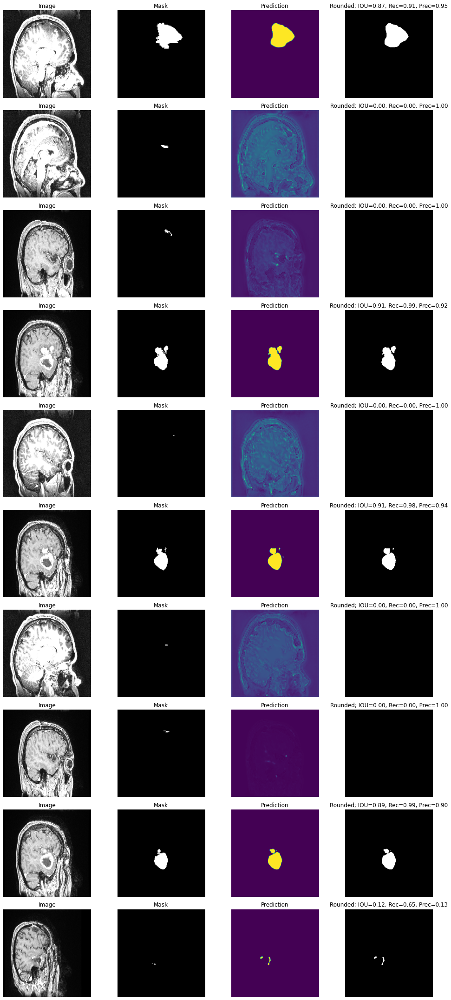

************************************************************


In [ ]:
outputs_df = train_model('/content/drive/MyDrive/OUTS/Sagittal/')

In [ ]:
outputs_df

,Epochs Number,Dice Score,IOU Score,Recall (Sensitivity),Precision,Global Accuracy,AUC-ROC
0,100,0.611,0.510,0.714,0.683,0.994,0.848
1,100,0.599,0.518,0.612,0.854,0.995,0.909
2,100,0.527,0.470,0.498,0.925,0.997,0.968
3,100,0.639,0.550,0.719,0.723,0.995,0.888
4,100,0.528,0.461,0.543,0.835,0.997,0.958


In [ ]:
outputs_df.mean()

Epochs Number           100.0000
Dice Score                0.5808
IOU Score                 0.5018
Recall (Sensitivity)      0.6172
Precision                 0.8040
Global Accuracy           0.9956
AUC-ROC                   0.9142
dtype: float64

In [ ]:
output_df.std()

Epochs Number           0.000000
Dice Score              0.050776
IOU Score               0.036499
Recall (Sensitivity)    0.099341
Precision               0.099126
Global Accuracy         0.001342
AUC-ROC                 0.049771
dtype: float64

## Coronal

154it [00:00, 238.01it/s]


Intializing Cross Validation

Run # 1
Epoch 1/100
16/16 [==============================] - 12s 573ms/step - loss: 0.9148 - dice_coef: 0.0839 - val_loss: 0.9670 - val_dice_coef: 0.0328
Epoch 2/100
16/16 [==============================] - 9s 549ms/step - loss: 0.8451 - dice_coef: 0.1570 - val_loss: 0.9658 - val_dice_coef: 0.0340
Epoch 3/100
16/16 [==============================] - 9s 549ms/step - loss: 0.7827 - dice_coef: 0.2217 - val_loss: 0.9679 - val_dice_coef: 0.0319
Epoch 4/100
16/16 [==============================] - 9s 554ms/step - loss: 0.7476 - dice_coef: 0.2506 - val_loss: 0.9670 - val_dice_coef: 0.0328
Epoch 5/100
16/16 [==============================] - 9s 553ms/step - loss: 0.7175 - dice_coef: 0.2876 - val_loss: 0.9668 - val_dice_coef: 0.0330
Epoch 6/100
16/16 [==============================] - 9s 545ms/step - loss: 0.6975 - dice_coef: 0.3003 - val_loss: 0.9668 - val_dice_coef: 0.0330
Epoch 7/100
16/16 [==============================] - 9s 546ms/step - loss: 0.6897 - dice_co

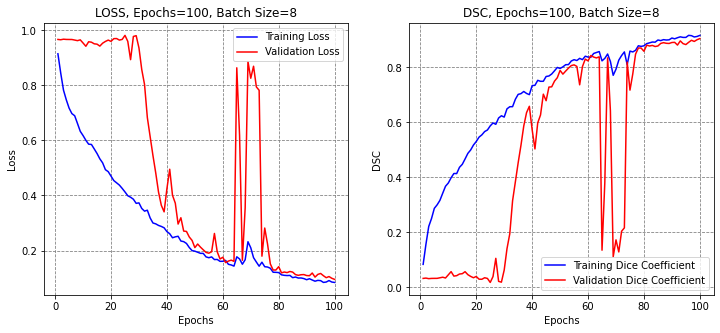

Testing time: 0:00:00.805330
Saving validation-fold predictions....
------------------------------
USING THRESHOLD 0.5

 DSC 		0.743 
 IOU 		0.695 
 Recall 	0.757 
 Precision	0.928
 Global Acc 	0.997
 AUC ROC 	0.960


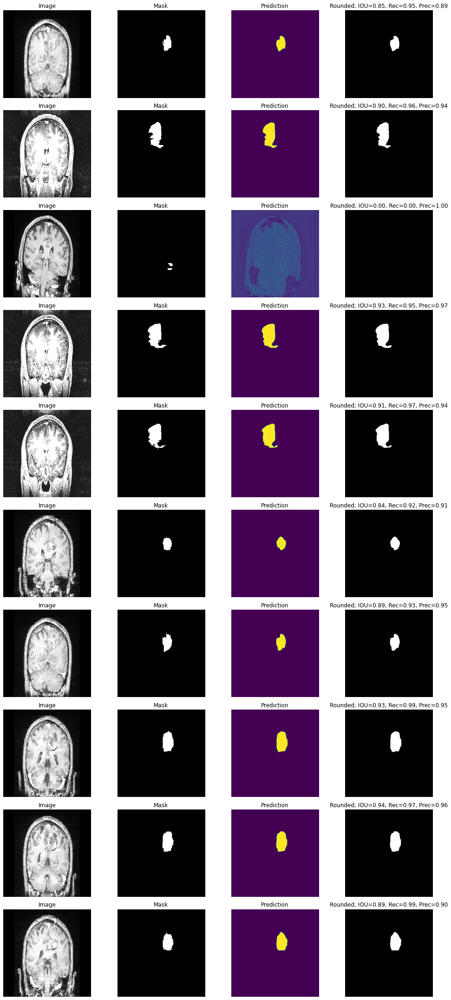

************************************************************

Run # 2
Epoch 1/100
16/16 [==============================] - 12s 594ms/step - loss: 0.9219 - dice_coef: 0.0787 - val_loss: 0.9705 - val_dice_coef: 0.0292
Epoch 2/100
16/16 [==============================] - 9s 553ms/step - loss: 0.8649 - dice_coef: 0.1391 - val_loss: 0.9702 - val_dice_coef: 0.0295
Epoch 3/100
16/16 [==============================] - 9s 589ms/step - loss: 0.8143 - dice_coef: 0.1875 - val_loss: 0.9721 - val_dice_coef: 0.0277
Epoch 4/100
16/16 [==============================] - 9s 588ms/step - loss: 0.7749 - dice_coef: 0.2249 - val_loss: 0.9710 - val_dice_coef: 0.0287
Epoch 5/100
16/16 [==============================] - 9s 545ms/step - loss: 0.7558 - dice_coef: 0.2453 - val_loss: 0.9715 - val_dice_coef: 0.0282
Epoch 6/100
16/16 [==============================] - 9s 551ms/step - loss: 0.7440 - dice_coef: 0.2574 - val_loss: 0.9700 - val_dice_coef: 0.0298
Epoch 7/100
16/16 [==============================] - 9s 544

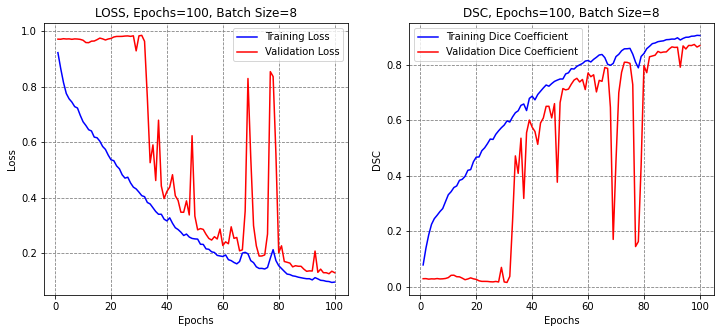

Testing time: 0:00:00.918479
Saving validation-fold predictions....
------------------------------
USING THRESHOLD 0.5

 DSC 		0.674 
 IOU 		0.622 
 Recall 	0.645 
 Precision	0.965
 Global Acc 	0.998
 AUC ROC 	0.982


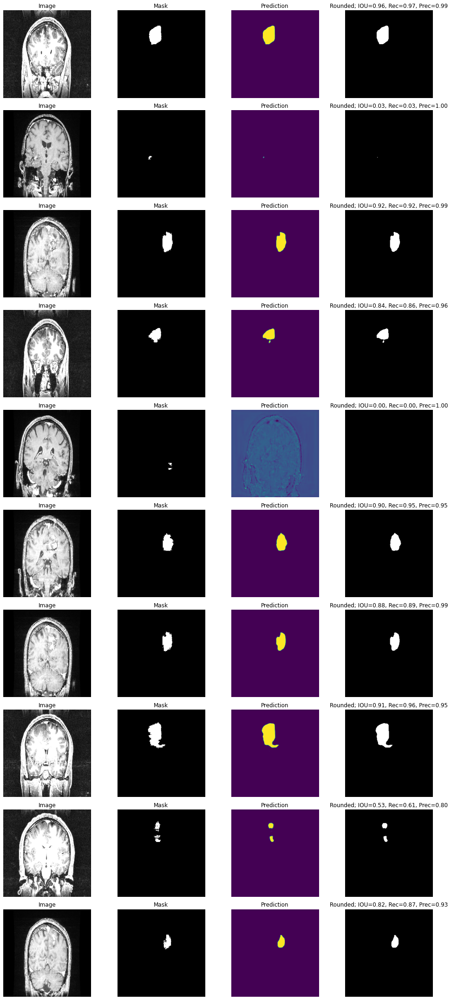

************************************************************

Run # 3
Epoch 1/100
16/16 [==============================] - 12s 578ms/step - loss: 0.9318 - dice_coef: 0.0685 - val_loss: 0.9611 - val_dice_coef: 0.0389
Epoch 2/100
16/16 [==============================] - 9s 592ms/step - loss: 0.8895 - dice_coef: 0.1084 - val_loss: 0.9578 - val_dice_coef: 0.0422
Epoch 3/100
16/16 [==============================] - 9s 591ms/step - loss: 0.8594 - dice_coef: 0.1396 - val_loss: 0.9636 - val_dice_coef: 0.0363
Epoch 4/100
16/16 [==============================] - 9s 548ms/step - loss: 0.8328 - dice_coef: 0.1671 - val_loss: 0.9590 - val_dice_coef: 0.0410
Epoch 5/100
16/16 [==============================] - 9s 546ms/step - loss: 0.8176 - dice_coef: 0.1826 - val_loss: 0.9622 - val_dice_coef: 0.0377
Epoch 6/100
16/16 [==============================] - 9s 543ms/step - loss: 0.8039 - dice_coef: 0.1926 - val_loss: 0.9619 - val_dice_coef: 0.0381
Epoch 7/100
16/16 [==============================] - 9s 542

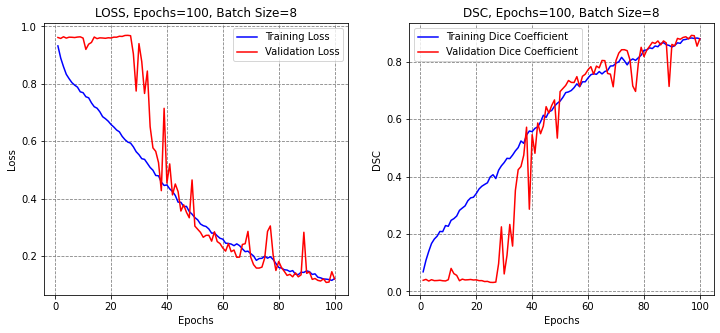

Testing time: 0:00:00.937110
Saving validation-fold predictions....
------------------------------
USING THRESHOLD 0.5

 DSC 		0.770 
 IOU 		0.720 
 Recall 	0.736 
 Precision	0.980
 Global Acc 	0.997
 AUC ROC 	0.988


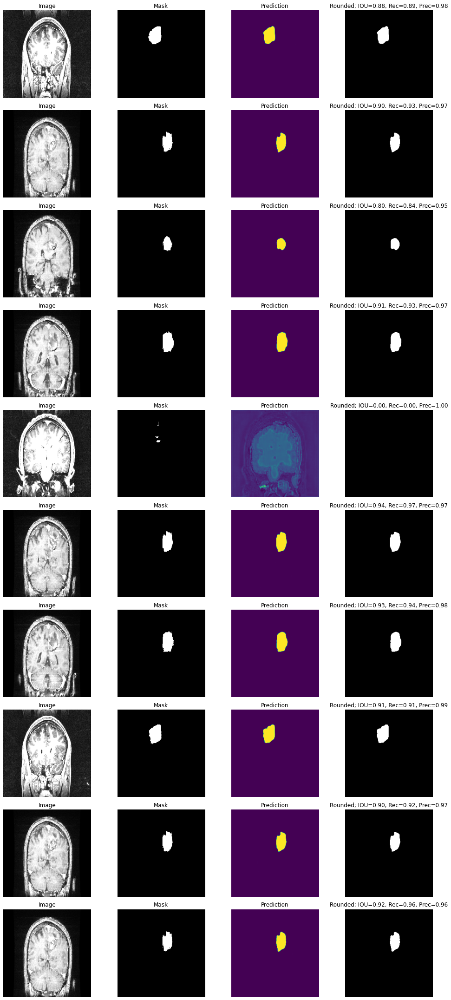

************************************************************

Run # 4
Epoch 1/100
16/16 [==============================] - 12s 581ms/step - loss: 0.9267 - dice_coef: 0.0739 - val_loss: 0.9672 - val_dice_coef: 0.0332
Epoch 2/100
16/16 [==============================] - 9s 547ms/step - loss: 0.8768 - dice_coef: 0.1243 - val_loss: 0.9673 - val_dice_coef: 0.0331
Epoch 3/100
16/16 [==============================] - 9s 552ms/step - loss: 0.8477 - dice_coef: 0.1535 - val_loss: 0.9705 - val_dice_coef: 0.0299
Epoch 4/100
16/16 [==============================] - 10s 592ms/step - loss: 0.8117 - dice_coef: 0.1916 - val_loss: 0.9707 - val_dice_coef: 0.0296
Epoch 5/100
16/16 [==============================] - 9s 545ms/step - loss: 0.7809 - dice_coef: 0.2211 - val_loss: 0.9707 - val_dice_coef: 0.0297
Epoch 6/100
16/16 [==============================] - 9s 545ms/step - loss: 0.7719 - dice_coef: 0.2297 - val_loss: 0.9704 - val_dice_coef: 0.0300
Epoch 7/100
16/16 [==============================] - 9s 54

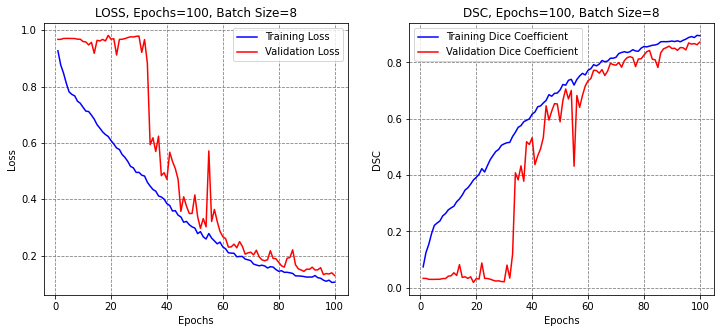

Testing time: 0:00:00.830835
Saving validation-fold predictions....
------------------------------
USING THRESHOLD 0.5

 DSC 		0.736 
 IOU 		0.676 
 Recall 	0.715 
 Precision	0.918
 Global Acc 	0.998
 AUC ROC 	0.971


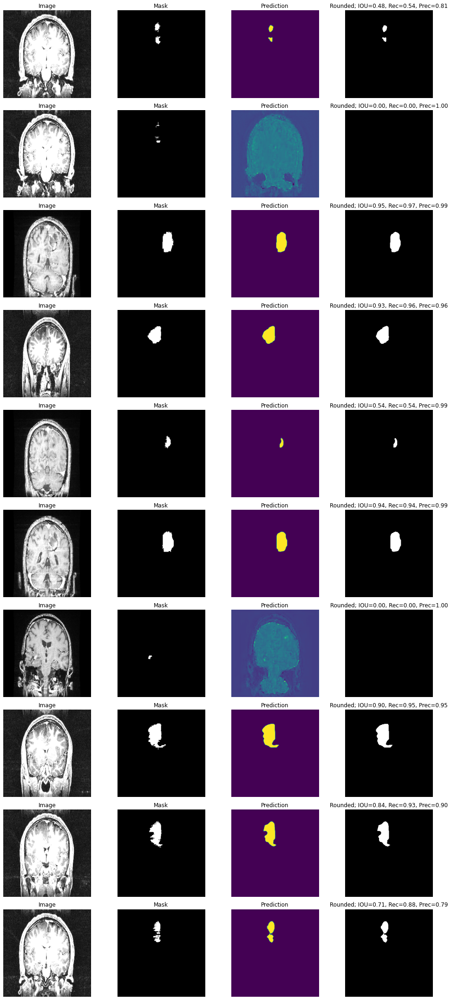

************************************************************

Run # 5
Epoch 1/100
16/16 [==============================] - 18s 993ms/step - loss: 0.9454 - dice_coef: 0.0546 - val_loss: 0.9634 - val_dice_coef: 0.0371
Epoch 2/100
16/16 [==============================] - 9s 554ms/step - loss: 0.9165 - dice_coef: 0.0833 - val_loss: 0.9641 - val_dice_coef: 0.0363
Epoch 3/100
16/16 [==============================] - 9s 559ms/step - loss: 0.8935 - dice_coef: 0.1071 - val_loss: 0.9594 - val_dice_coef: 0.0411
Epoch 4/100
16/16 [==============================] - 9s 553ms/step - loss: 0.8782 - dice_coef: 0.1196 - val_loss: 0.9659 - val_dice_coef: 0.0345
Epoch 5/100
16/16 [==============================] - 9s 548ms/step - loss: 0.8628 - dice_coef: 0.1385 - val_loss: 0.9659 - val_dice_coef: 0.0345
Epoch 6/100
16/16 [==============================] - 9s 544ms/step - loss: 0.8554 - dice_coef: 0.1462 - val_loss: 0.9654 - val_dice_coef: 0.0351
Epoch 7/100
16/16 [==============================] - 9s 544

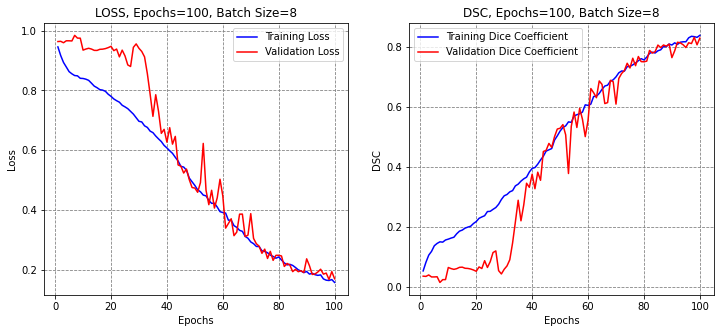

Testing time: 0:00:10.565842
Saving validation-fold predictions....
------------------------------
USING THRESHOLD 0.5

 DSC 		0.732 
 IOU 		0.678 
 Recall 	0.700 
 Precision	0.970
 Global Acc 	0.997
 AUC ROC 	0.982


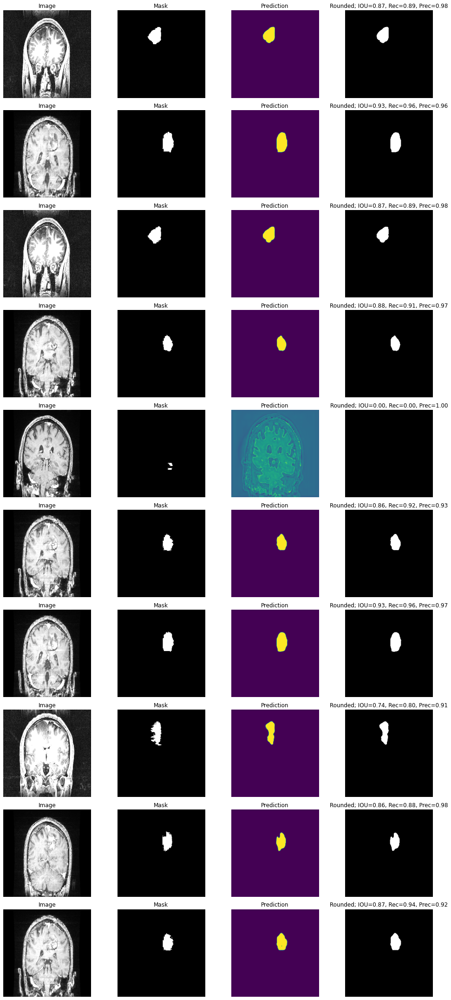

************************************************************


In [ ]:
outputs_df = train_model('/content/drive/MyDrive/OUTS/Coronal/')

In [ ]:
outputs_df

,Epochs Number,Dice Score,IOU Score,Recall (Sensitivity),Precision,Global Accuracy,AUC-ROC
0,100.0,0.742559,0.695316,0.756806,0.927753,0.997313,0.959951
1,100.0,0.674084,0.622253,0.645000,0.964780,0.997729,0.981619
2,100.0,0.770154,0.719753,0.735823,0.980426,0.997344,0.987683
3,100.0,0.736196,0.676055,0.714698,0.917911,0.997555,0.971031
4,100.0,0.731659,0.677712,0.700072,0.969870,0.996910,0.981931


In [ ]:
outputs_df.mean()

Epochs Number           100.000000
Dice Score                0.730930
IOU Score                 0.678218
Recall (Sensitivity)      0.710480
Precision                 0.952148
Global Accuracy           0.997370
AUC-ROC                   0.976443
dtype: float64

In [ ]:
outputs_df.std()

Epochs Number           0.000000
Dice Score              0.035119
IOU Score               0.035898
Recall (Sensitivity)    0.042433
Precision               0.027571
Global Accuracy         0.000308
AUC-ROC                 0.011006
dtype: float64

# LinkNet

## Transversal

530it [00:03, 147.14it/s]


Intializing Cross Validation

Run # 1
Epoch 1/100
53/53 [==============================] - 9s 79ms/step - loss: 0.9659 - dsc: 0.0333 - dice_coef: 0.0341 - val_loss: 0.9699 - val_dsc: 0.0284 - val_dice_coef: 0.0289
Epoch 2/100
53/53 [==============================] - 3s 60ms/step - loss: 0.9416 - dsc: 0.0566 - dice_coef: 0.0584 - val_loss: 0.9602 - val_dsc: 0.0374 - val_dice_coef: 0.0381
Epoch 3/100
53/53 [==============================] - 3s 60ms/step - loss: 0.9285 - dsc: 0.0693 - dice_coef: 0.0715 - val_loss: 0.9499 - val_dsc: 0.0469 - val_dice_coef: 0.0480
Epoch 4/100
53/53 [==============================] - 4s 65ms/step - loss: 0.9206 - dsc: 0.0768 - dice_coef: 0.0794 - val_loss: 0.9383 - val_dsc: 0.0578 - val_dice_coef: 0.0592
Epoch 5/100
53/53 [==============================] - 3s 61ms/step - loss: 0.9123 - dsc: 0.0846 - dice_coef: 0.0877 - val_loss: 0.9310 - val_dsc: 0.0640 - val_dice_coef: 0.0662
Epoch 6/100
53/53 [==============================] - 3s 62ms/step - loss: 0.9014 -

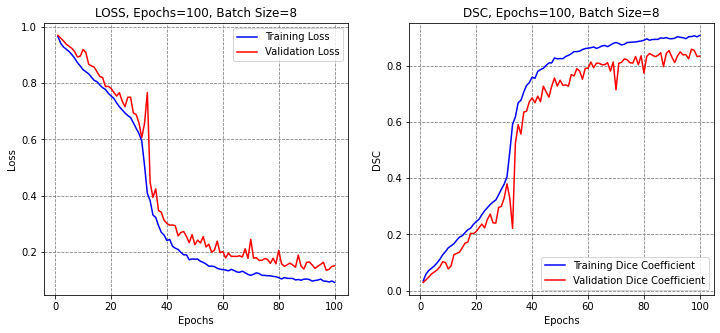

Testing time: 0:00:01.949267
------------------------------
USING THRESHOLD 0.5

 DSC 		0.706 
 IOU 		0.617 
 Recall 	0.681 
 Precision	0.865
 Global Acc 	0.997
 AUC ROC 	0.952


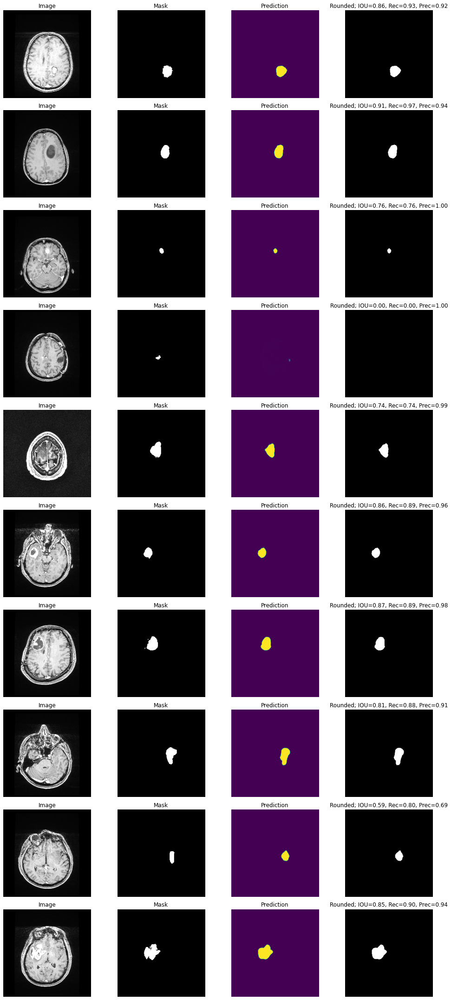

************************************************************

Run # 2
Epoch 1/100
53/53 [==============================] - 9s 84ms/step - loss: 0.9726 - dsc: 0.0269 - dice_coef: 0.0274 - val_loss: 0.9761 - val_dsc: 0.0227 - val_dice_coef: 0.0231
Epoch 2/100
53/53 [==============================] - 4s 67ms/step - loss: 0.9480 - dsc: 0.0506 - dice_coef: 0.0520 - val_loss: 0.9663 - val_dsc: 0.0318 - val_dice_coef: 0.0325
Epoch 3/100
53/53 [==============================] - 4s 67ms/step - loss: 0.9244 - dsc: 0.0734 - dice_coef: 0.0756 - val_loss: 0.9555 - val_dsc: 0.0421 - val_dice_coef: 0.0429
Epoch 4/100
53/53 [==============================] - 4s 68ms/step - loss: 0.9024 - dsc: 0.0942 - dice_coef: 0.0976 - val_loss: 0.9446 - val_dsc: 0.0522 - val_dice_coef: 0.0533
Epoch 5/100
53/53 [==============================] - 4s 67ms/step - loss: 0.8867 - dsc: 0.1085 - dice_coef: 0.1133 - val_loss: 0.9283 - val_dsc: 0.0671 - val_dice_coef: 0.0690
Epoch 6/100
53/53 [==============================]

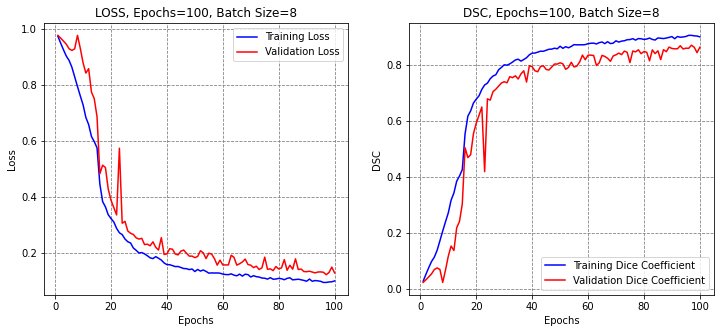

Testing time: 0:00:00.934047
------------------------------
USING THRESHOLD 0.5

 DSC 		0.691 
 IOU 		0.615 
 Recall 	0.669 
 Precision	0.892
 Global Acc 	0.997
 AUC ROC 	0.954


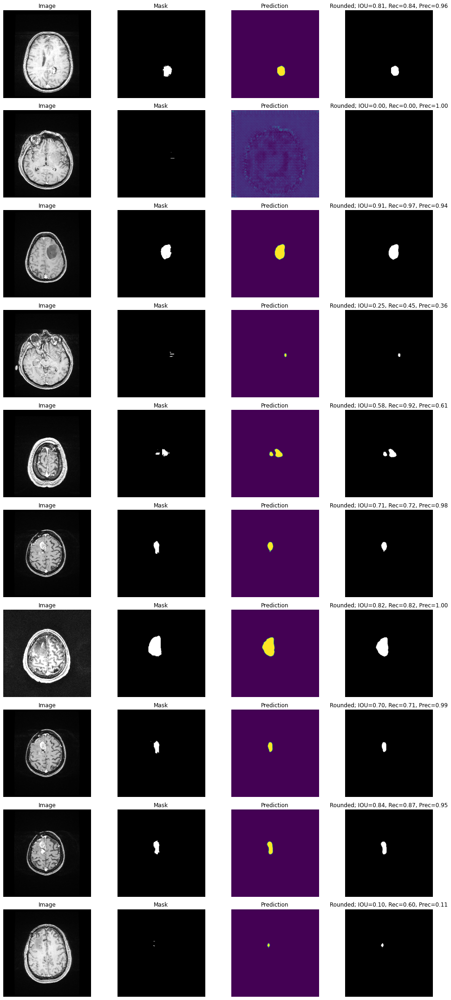

************************************************************

Run # 3
Epoch 1/100
53/53 [==============================] - 10s 89ms/step - loss: 0.9678 - dsc: 0.0315 - dice_coef: 0.0322 - val_loss: 0.9670 - val_dsc: 0.0309 - val_dice_coef: 0.0313
Epoch 2/100
53/53 [==============================] - 4s 71ms/step - loss: 0.9310 - dsc: 0.0669 - dice_coef: 0.0690 - val_loss: 0.9500 - val_dsc: 0.0466 - val_dice_coef: 0.0475
Epoch 3/100
53/53 [==============================] - 4s 71ms/step - loss: 0.9053 - dsc: 0.0920 - dice_coef: 0.0947 - val_loss: 0.9243 - val_dsc: 0.0700 - val_dice_coef: 0.0720
Epoch 4/100
53/53 [==============================] - 4s 68ms/step - loss: 0.8891 - dsc: 0.1077 - dice_coef: 0.1109 - val_loss: 0.9013 - val_dsc: 0.0896 - val_dice_coef: 0.0938
Epoch 5/100
53/53 [==============================] - 4s 71ms/step - loss: 0.8720 - dsc: 0.1220 - dice_coef: 0.1280 - val_loss: 0.9065 - val_dsc: 0.0867 - val_dice_coef: 0.0888
Epoch 6/100
53/53 [==============================

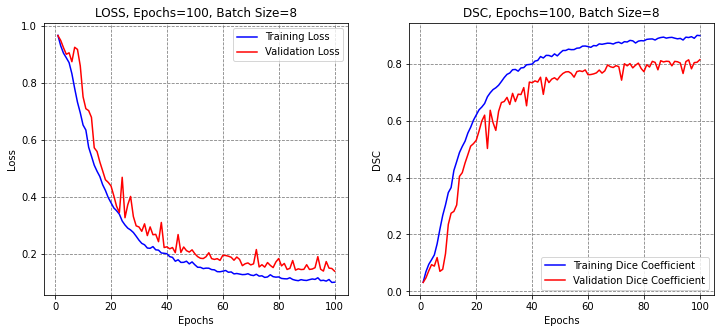

Testing time: 0:00:01.322034
------------------------------
USING THRESHOLD 0.5

 DSC 		0.746 
 IOU 		0.664 
 Recall 	0.769 
 Precision	0.837
 Global Acc 	0.997
 AUC ROC 	0.930


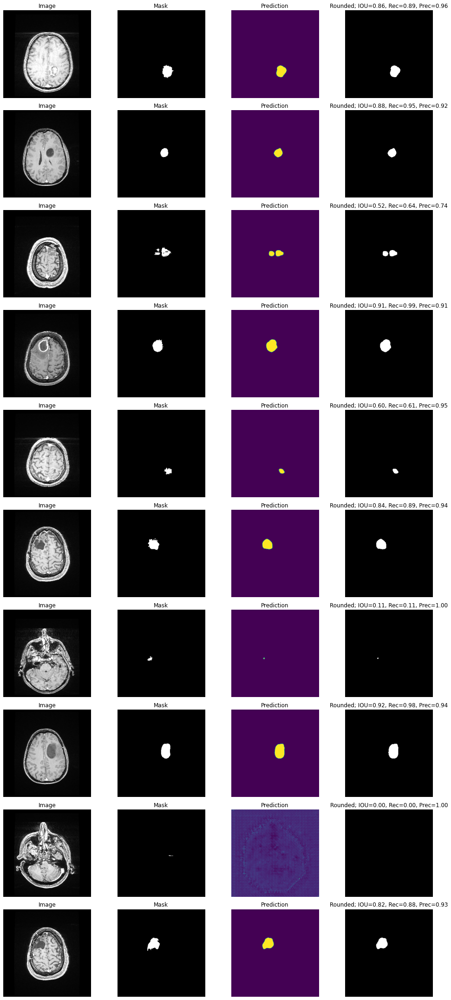

************************************************************

Run # 4
Epoch 1/100
53/53 [==============================] - 10s 90ms/step - loss: 0.9668 - dsc: 0.0324 - dice_coef: 0.0332 - val_loss: 0.9647 - val_dsc: 0.0353 - val_dice_coef: 0.0361
Epoch 2/100
53/53 [==============================] - 4s 71ms/step - loss: 0.9421 - dsc: 0.0560 - dice_coef: 0.0579 - val_loss: 0.9531 - val_dsc: 0.0467 - val_dice_coef: 0.0478
Epoch 3/100
53/53 [==============================] - 4s 72ms/step - loss: 0.9267 - dsc: 0.0708 - dice_coef: 0.0733 - val_loss: 0.9376 - val_dsc: 0.0619 - val_dice_coef: 0.0637
Epoch 4/100
53/53 [==============================] - 4s 75ms/step - loss: 0.9161 - dsc: 0.0809 - dice_coef: 0.0839 - val_loss: 0.9221 - val_dsc: 0.0769 - val_dice_coef: 0.0794
Epoch 5/100
53/53 [==============================] - 4s 70ms/step - loss: 0.9056 - dsc: 0.0903 - dice_coef: 0.0944 - val_loss: 0.9273 - val_dsc: 0.0727 - val_dice_coef: 0.0746
Epoch 6/100
53/53 [==============================

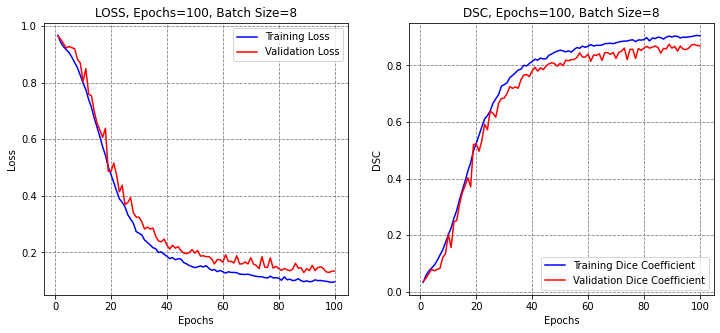

Testing time: 0:00:00.867072
------------------------------
USING THRESHOLD 0.5

 DSC 		0.754 
 IOU 		0.668 
 Recall 	0.721 
 Precision	0.897
 Global Acc 	0.997
 AUC ROC 	0.955


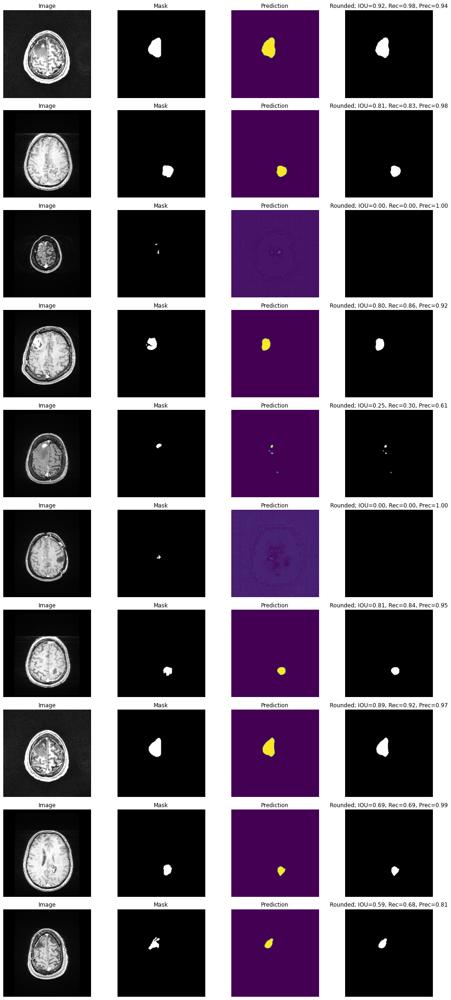

************************************************************

Run # 5
Epoch 1/100
53/53 [==============================] - 10s 93ms/step - loss: 0.9718 - dsc: 0.0277 - dice_coef: 0.0282 - val_loss: 0.9669 - val_dsc: 0.0324 - val_dice_coef: 0.0332
Epoch 2/100
53/53 [==============================] - 4s 75ms/step - loss: 0.9474 - dsc: 0.0511 - dice_coef: 0.0526 - val_loss: 0.9556 - val_dsc: 0.0430 - val_dice_coef: 0.0444
Epoch 3/100
53/53 [==============================] - 4s 76ms/step - loss: 0.9249 - dsc: 0.0729 - dice_coef: 0.0751 - val_loss: 0.9414 - val_dsc: 0.0564 - val_dice_coef: 0.0585
Epoch 4/100
53/53 [==============================] - 4s 75ms/step - loss: 0.9035 - dsc: 0.0939 - dice_coef: 0.0965 - val_loss: 0.9254 - val_dsc: 0.0710 - val_dice_coef: 0.0742
Epoch 5/100
53/53 [==============================] - 4s 75ms/step - loss: 0.8868 - dsc: 0.1085 - dice_coef: 0.1132 - val_loss: 0.9136 - val_dsc: 0.0813 - val_dice_coef: 0.0861
Epoch 6/100
53/53 [==============================

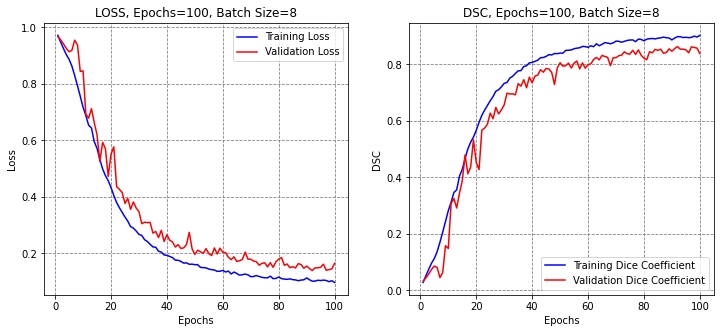

Testing time: 0:00:00.993157
------------------------------
USING THRESHOLD 0.5

 DSC 		0.674 
 IOU 		0.584 
 Recall 	0.618 
 Precision	0.910
 Global Acc 	0.997
 AUC ROC 	0.966


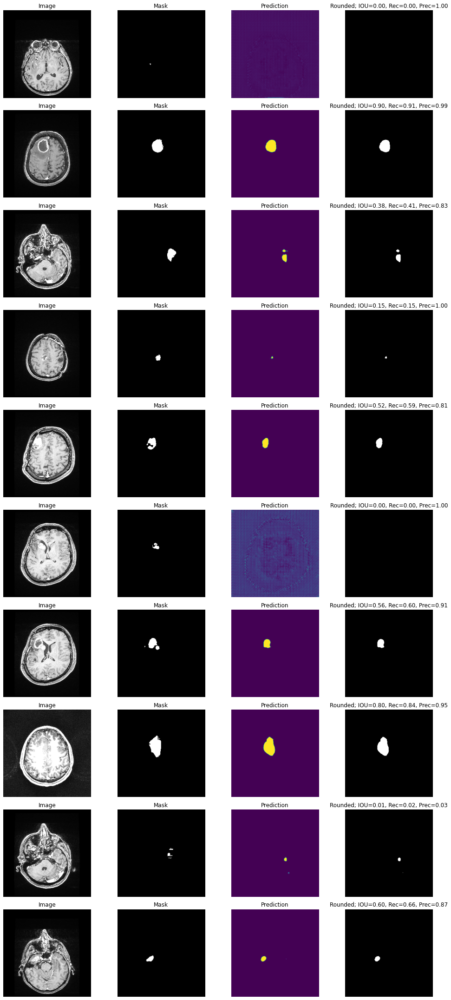

************************************************************


In [ ]:
outputs_df = train_model()

In [ ]:
outputs_df

,Epochs Number,Dice Score,IOU Score,Recall (Sensitivity),Precision,Global Accuracy,AUC-ROC
0,100.0,0.706073,0.616520,0.681363,0.864598,0.997277,0.951577
1,100.0,0.691366,0.614957,0.669363,0.892192,0.997394,0.953875
2,100.0,0.745724,0.663788,0.768781,0.837120,0.997239,0.930221
3,100.0,0.754347,0.668312,0.721254,0.897436,0.997165,0.954772
4,100.0,0.674009,0.584358,0.618238,0.910354,0.996904,0.965932


In [ ]:
outputs_df.mean()

Epochs Number           100.000000
Dice Score                0.714304
IOU Score                 0.629587
Recall (Sensitivity)      0.691800
Precision                 0.880340
Global Accuracy           0.997196
AUC-ROC                   0.951275
dtype: float64

In [ ]:
outputs_df.std()

Epochs Number           0.000000
Dice Score              0.034671
IOU Score               0.035707
Recall (Sensitivity)    0.056606
Precision               0.029366
Global Accuracy         0.000183
AUC-ROC                 0.013011
dtype: float64

## Sagittal

162it [00:00, 220.42it/s]


Intializing Cross Validation

Run # 1
Epoch 1/100
17/17 [==============================] - 7s 123ms/step - loss: 0.9703 - dsc: 0.0274 - dice_coef: 0.0283 - val_loss: 0.9789 - val_dsc: 0.0173 - val_dice_coef: 0.0177
Epoch 2/100
17/17 [==============================] - 1s 62ms/step - loss: 0.9658 - dsc: 0.0314 - dice_coef: 0.0329 - val_loss: 0.9791 - val_dsc: 0.0173 - val_dice_coef: 0.0175
Epoch 3/100
17/17 [==============================] - 1s 66ms/step - loss: 0.9616 - dsc: 0.0407 - dice_coef: 0.0425 - val_loss: 0.9761 - val_dsc: 0.0196 - val_dice_coef: 0.0201
Epoch 4/100
17/17 [==============================] - 1s 64ms/step - loss: 0.9575 - dsc: 0.0394 - dice_coef: 0.0420 - val_loss: 0.9728 - val_dsc: 0.0217 - val_dice_coef: 0.0228
Epoch 5/100
17/17 [==============================] - 1s 64ms/step - loss: 0.9543 - dsc: 0.0481 - dice_coef: 0.0511 - val_loss: 0.9716 - val_dsc: 0.0224 - val_dice_coef: 0.0238
Epoch 6/100
17/17 [==============================] - 1s 69ms/step - loss: 0.9509 

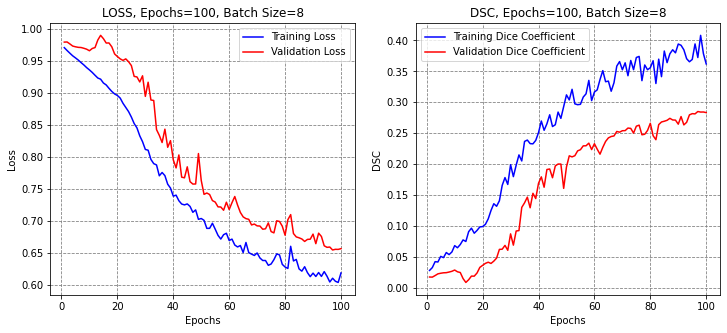

Testing time: 0:00:00.725071
------------------------------
USING THRESHOLD 0.5

 DSC 		0.249 
 IOU 		0.166 
 Recall 	0.706 
 Precision	0.169
 Global Acc 	0.965
 AUC ROC 	0.620


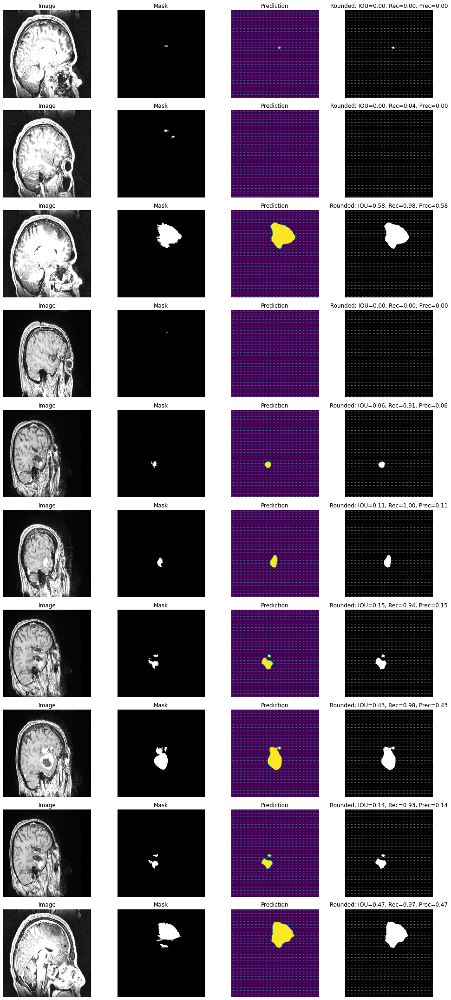

************************************************************

Run # 2
Epoch 1/100
17/17 [==============================] - 7s 133ms/step - loss: 0.9722 - dsc: 0.0255 - dice_coef: 0.0264 - val_loss: 0.9675 - val_dsc: 0.0267 - val_dice_coef: 0.0275
Epoch 2/100
17/17 [==============================] - 1s 71ms/step - loss: 0.9686 - dsc: 0.0296 - dice_coef: 0.0311 - val_loss: 0.9651 - val_dsc: 0.0283 - val_dice_coef: 0.0296
Epoch 3/100
17/17 [==============================] - 1s 72ms/step - loss: 0.9642 - dsc: 0.0365 - dice_coef: 0.0385 - val_loss: 0.9635 - val_dsc: 0.0294 - val_dice_coef: 0.0309
Epoch 4/100
17/17 [==============================] - 1s 72ms/step - loss: 0.9600 - dsc: 0.0366 - dice_coef: 0.0392 - val_loss: 0.9620 - val_dsc: 0.0304 - val_dice_coef: 0.0323
Epoch 5/100
17/17 [==============================] - 1s 74ms/step - loss: 0.9557 - dsc: 0.0402 - dice_coef: 0.0432 - val_loss: 0.9605 - val_dsc: 0.0313 - val_dice_coef: 0.0335
Epoch 6/100
17/17 [==============================

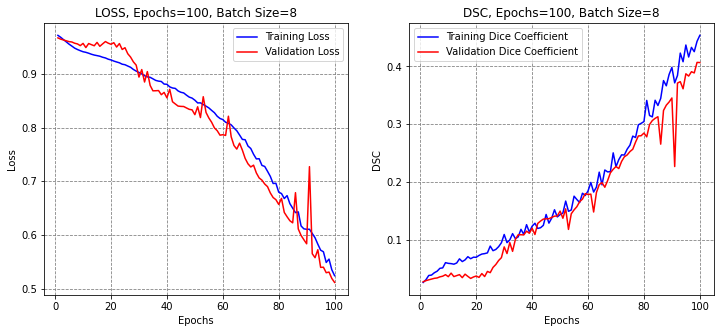

Testing time: 0:00:00.852358
------------------------------
USING THRESHOLD 0.5

 DSC 		0.647 
 IOU 		0.547 
 Recall 	0.737 
 Precision	0.715
 Global Acc 	0.995
 AUC ROC 	0.906


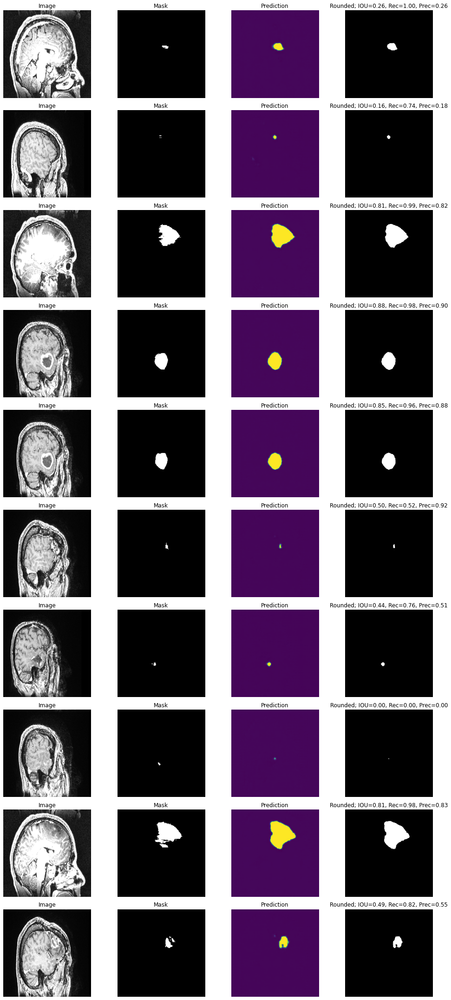

************************************************************

Run # 3
Epoch 1/100
17/17 [==============================] - 7s 126ms/step - loss: 0.9735 - dsc: 0.0262 - dice_coef: 0.0271 - val_loss: 0.9731 - val_dsc: 0.0262 - val_dice_coef: 0.0269
Epoch 2/100
17/17 [==============================] - 1s 72ms/step - loss: 0.9705 - dsc: 0.0290 - dice_coef: 0.0306 - val_loss: 0.9725 - val_dsc: 0.0267 - val_dice_coef: 0.0275
Epoch 3/100
17/17 [==============================] - 1s 71ms/step - loss: 0.9665 - dsc: 0.0300 - dice_coef: 0.0321 - val_loss: 0.9696 - val_dsc: 0.0293 - val_dice_coef: 0.0304
Epoch 4/100
17/17 [==============================] - 1s 75ms/step - loss: 0.9614 - dsc: 0.0344 - dice_coef: 0.0370 - val_loss: 0.9655 - val_dsc: 0.0329 - val_dice_coef: 0.0345
Epoch 5/100
17/17 [==============================] - 1s 76ms/step - loss: 0.9541 - dsc: 0.0441 - dice_coef: 0.0488 - val_loss: 0.9605 - val_dsc: 0.0373 - val_dice_coef: 0.0395
Epoch 6/100
17/17 [==============================

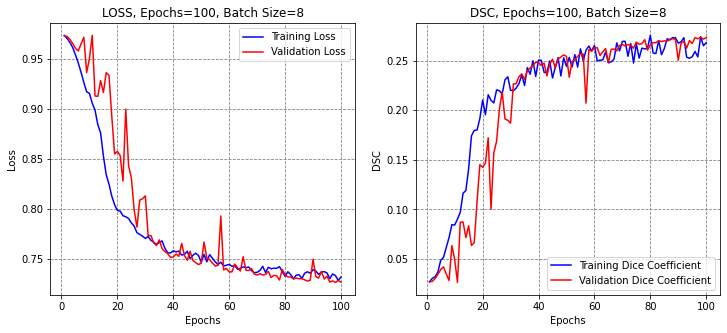

Testing time: 0:00:01.159106
------------------------------
USING THRESHOLD 0.5

 DSC 		0.217 
 IOU 		0.138 
 Recall 	0.744 
 Precision	0.139
 Global Acc 	0.933
 AUC ROC 	0.585


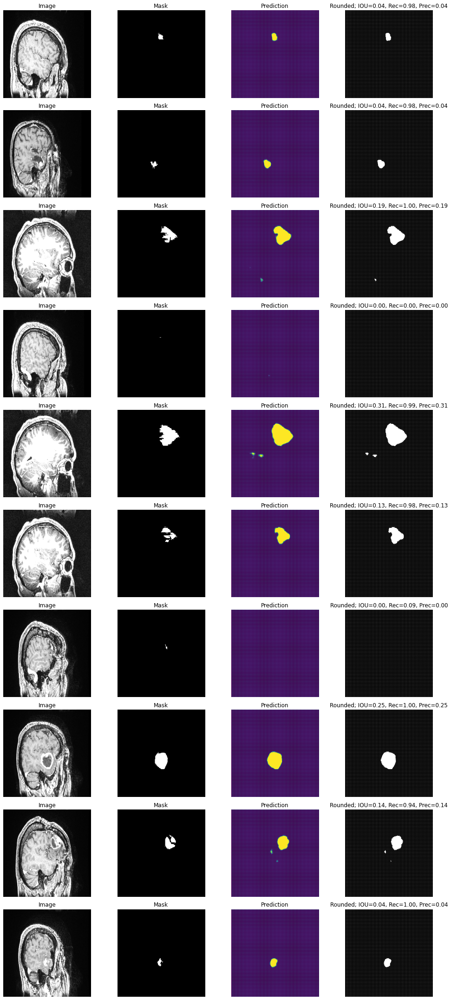

************************************************************

Run # 4
Epoch 1/100
17/17 [==============================] - 7s 132ms/step - loss: 0.9730 - dsc: 0.0250 - dice_coef: 0.0260 - val_loss: 0.9729 - val_dsc: 0.0264 - val_dice_coef: 0.0271
Epoch 2/100
17/17 [==============================] - 1s 70ms/step - loss: 0.9673 - dsc: 0.0300 - dice_coef: 0.0321 - val_loss: 0.9700 - val_dsc: 0.0289 - val_dice_coef: 0.0300
Epoch 3/100
17/17 [==============================] - 1s 74ms/step - loss: 0.9593 - dsc: 0.0380 - dice_coef: 0.0423 - val_loss: 0.9665 - val_dsc: 0.0320 - val_dice_coef: 0.0335
Epoch 4/100
17/17 [==============================] - 1s 78ms/step - loss: 0.9516 - dsc: 0.0446 - dice_coef: 0.0488 - val_loss: 0.9624 - val_dsc: 0.0355 - val_dice_coef: 0.0376
Epoch 5/100
17/17 [==============================] - 1s 76ms/step - loss: 0.9424 - dsc: 0.0498 - dice_coef: 0.0563 - val_loss: 0.9566 - val_dsc: 0.0404 - val_dice_coef: 0.0434
Epoch 6/100
17/17 [==============================

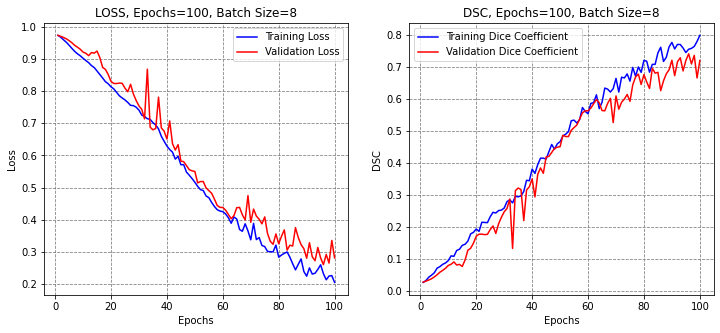

Testing time: 0:00:00.731482
------------------------------
USING THRESHOLD 0.5

 DSC 		0.648 
 IOU 		0.557 
 Recall 	0.656 
 Precision	0.853
 Global Acc 	0.996
 AUC ROC 	0.943


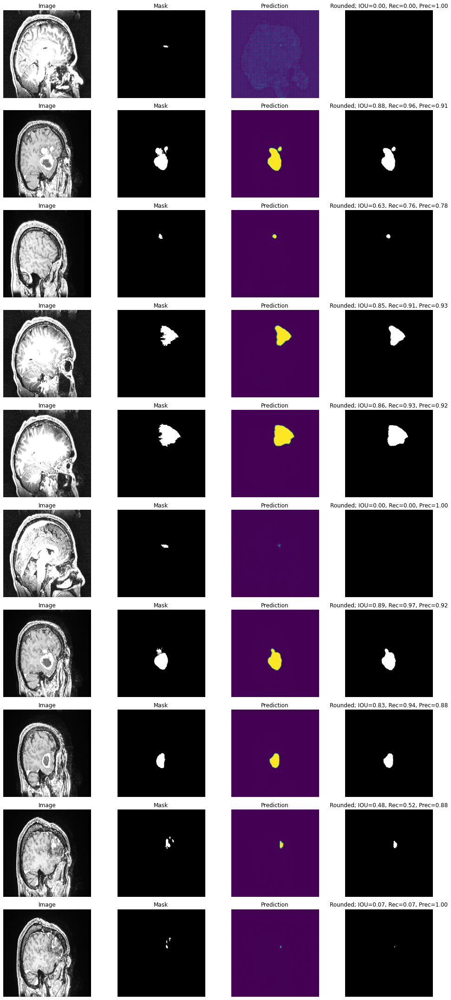

************************************************************

Run # 5
Epoch 1/100
17/17 [==============================] - 7s 135ms/step - loss: 0.9719 - dsc: 0.0262 - dice_coef: 0.0270 - val_loss: 0.9758 - val_dsc: 0.0234 - val_dice_coef: 0.0242
Epoch 2/100
17/17 [==============================] - 1s 74ms/step - loss: 0.9688 - dsc: 0.0307 - dice_coef: 0.0322 - val_loss: 0.9742 - val_dsc: 0.0249 - val_dice_coef: 0.0258
Epoch 3/100
17/17 [==============================] - 1s 75ms/step - loss: 0.9643 - dsc: 0.0336 - dice_coef: 0.0358 - val_loss: 0.9712 - val_dsc: 0.0275 - val_dice_coef: 0.0288
Epoch 4/100
17/17 [==============================] - 2s 82ms/step - loss: 0.9587 - dsc: 0.0379 - dice_coef: 0.0405 - val_loss: 0.9685 - val_dsc: 0.0299 - val_dice_coef: 0.0315
Epoch 5/100
17/17 [==============================] - 2s 80ms/step - loss: 0.9517 - dsc: 0.0460 - dice_coef: 0.0501 - val_loss: 0.9659 - val_dsc: 0.0321 - val_dice_coef: 0.0341
Epoch 6/100
17/17 [==============================

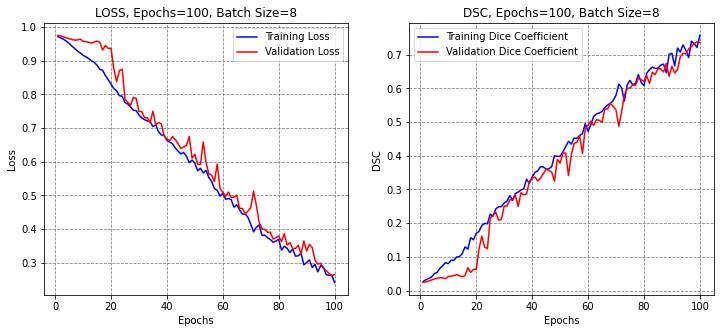

Testing time: 0:00:00.757413
------------------------------
USING THRESHOLD 0.5

 DSC 		0.535 
 IOU 		0.464 
 Recall 	0.519 
 Precision	0.885
 Global Acc 	0.997
 AUC ROC 	0.958


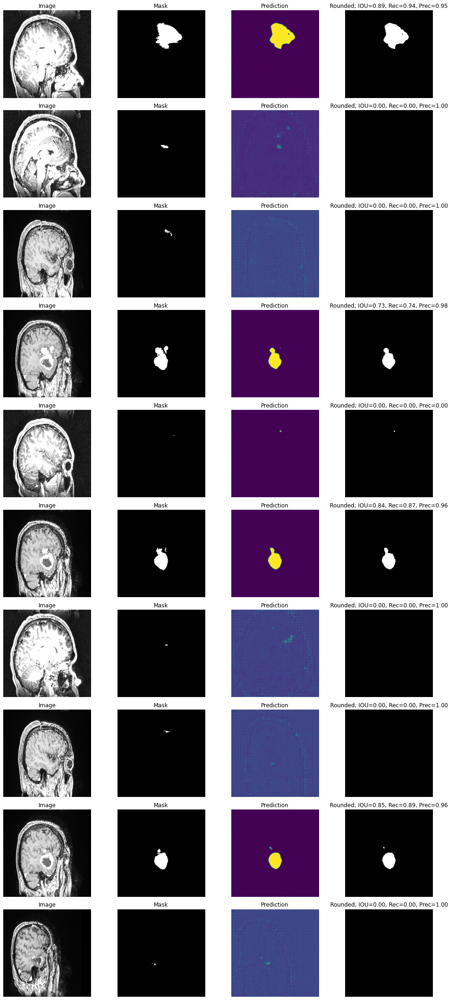

************************************************************


In [ ]:
outputs_df = train_model()

In [ ]:
outputs_df 

,Epochs Number,Dice Score,IOU Score,Recall (Sensitivity),Precision,Global Accuracy,AUC-ROC
0,100.0,0.248525,0.165884,0.706225,0.168755,0.964803,0.620257
1,100.0,0.646610,0.546851,0.736713,0.715429,0.995213,0.906482
2,100.0,0.217080,0.138141,0.744493,0.138778,0.933383,0.584550
3,100.0,0.647522,0.556951,0.656090,0.853435,0.996036,0.943460
4,100.0,0.535444,0.463924,0.518642,0.884557,0.997024,0.957623


In [ ]:
outputs_df.mean()

Epochs Number           100.000000
Dice Score                0.519525
IOU Score                 0.433403
Recall (Sensitivity)      0.654417
Precision                 0.655544
Global Accuracy           0.988269
AUC-ROC                   0.856955
dtype: float64

In [ ]:
outputs_df.std()

Epochs Number           0.000000
Dice Score              0.188174
IOU Score               0.183150
Recall (Sensitivity)    0.096427
Precision               0.332745
Global Accuracy         0.015661
AUC-ROC                 0.159265
dtype: float64

## Coronal

154it [00:00, 167.55it/s]


Intializing Cross Validation

Run # 1
Epoch 1/100
16/16 [==============================] - 20s 197ms/step - loss: 0.9632 - dsc: 0.0366 - dice_coef: 0.0371 - val_loss: 0.9651 - val_dsc: 0.0342 - val_dice_coef: 0.0347
Epoch 2/100
16/16 [==============================] - 1s 68ms/step - loss: 0.9522 - dsc: 0.0461 - dice_coef: 0.0468 - val_loss: 0.9607 - val_dsc: 0.0383 - val_dice_coef: 0.0391
Epoch 3/100
16/16 [==============================] - 1s 65ms/step - loss: 0.9410 - dsc: 0.0582 - dice_coef: 0.0594 - val_loss: 0.9568 - val_dsc: 0.0419 - val_dice_coef: 0.0430
Epoch 4/100
16/16 [==============================] - 1s 62ms/step - loss: 0.9321 - dsc: 0.0684 - dice_coef: 0.0698 - val_loss: 0.9525 - val_dsc: 0.0459 - val_dice_coef: 0.0472
Epoch 5/100
16/16 [==============================] - 1s 67ms/step - loss: 0.9241 - dsc: 0.0762 - dice_coef: 0.0778 - val_loss: 0.9492 - val_dsc: 0.0488 - val_dice_coef: 0.0505
Epoch 6/100
16/16 [==============================] - 1s 61ms/step - loss: 0.9148

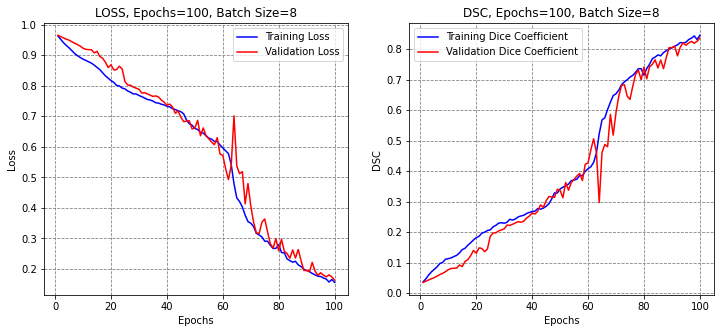

Testing time: 0:00:01.266871
------------------------------
USING THRESHOLD 0.5

 DSC 		0.705 
 IOU 		0.649 
 Recall 	0.728 
 Precision	0.914
 Global Acc 	0.997
 AUC ROC 	0.952


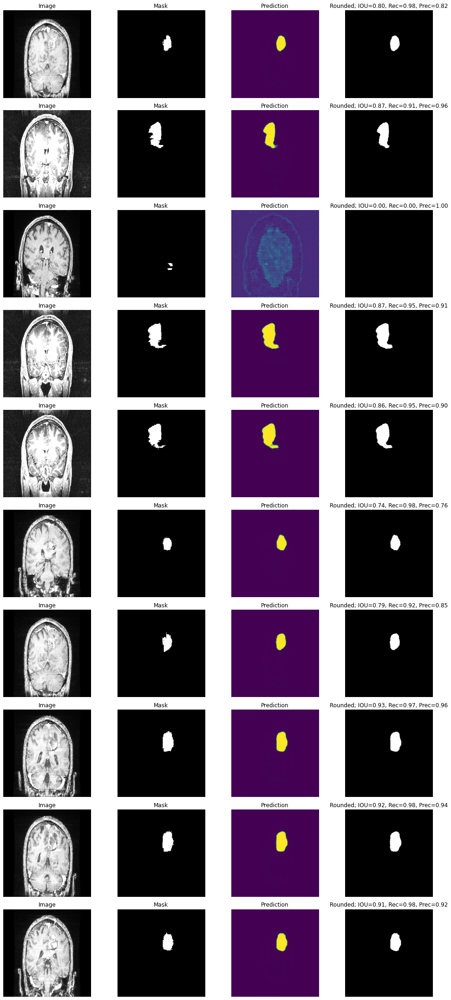

************************************************************

Run # 2
Epoch 1/100
16/16 [==============================] - 6s 130ms/step - loss: 0.9662 - dsc: 0.0335 - dice_coef: 0.0340 - val_loss: 0.9722 - val_dsc: 0.0272 - val_dice_coef: 0.0276
Epoch 2/100
16/16 [==============================] - 1s 72ms/step - loss: 0.9569 - dsc: 0.0425 - dice_coef: 0.0434 - val_loss: 0.9682 - val_dsc: 0.0309 - val_dice_coef: 0.0315
Epoch 3/100
16/16 [==============================] - 1s 70ms/step - loss: 0.9447 - dsc: 0.0549 - dice_coef: 0.0562 - val_loss: 0.9638 - val_dsc: 0.0349 - val_dice_coef: 0.0359
Epoch 4/100
16/16 [==============================] - 1s 69ms/step - loss: 0.9328 - dsc: 0.0646 - dice_coef: 0.0664 - val_loss: 0.9592 - val_dsc: 0.0392 - val_dice_coef: 0.0404
Epoch 5/100
16/16 [==============================] - 1s 68ms/step - loss: 0.9215 - dsc: 0.0772 - dice_coef: 0.0794 - val_loss: 0.9542 - val_dsc: 0.0438 - val_dice_coef: 0.0453
Epoch 6/100
16/16 [==============================

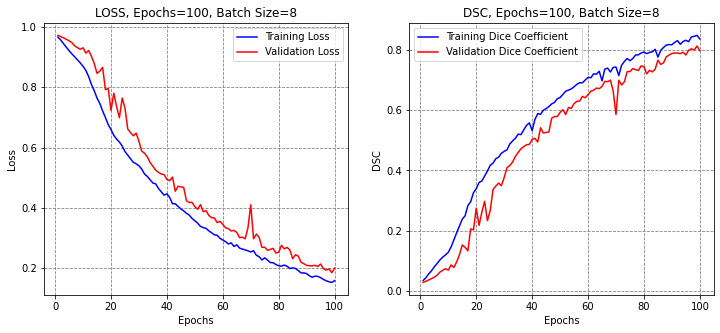

Testing time: 0:00:01.126566
------------------------------
USING THRESHOLD 0.5

 DSC 		0.650 
 IOU 		0.589 
 Recall 	0.640 
 Precision	0.928
 Global Acc 	0.997
 AUC ROC 	0.966


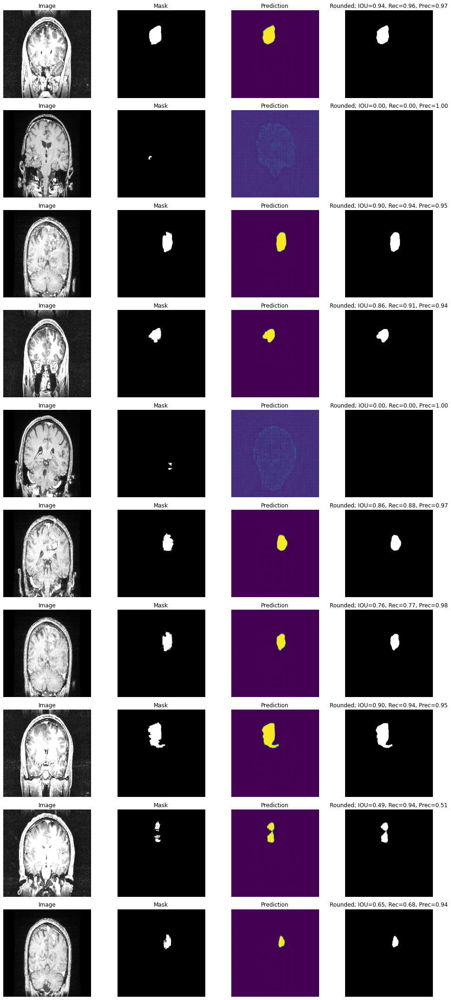

************************************************************

Run # 3
Epoch 1/100
16/16 [==============================] - 7s 134ms/step - loss: 0.9691 - dsc: 0.0308 - dice_coef: 0.0312 - val_loss: 0.9683 - val_dsc: 0.0313 - val_dice_coef: 0.0317
Epoch 2/100
16/16 [==============================] - 1s 65ms/step - loss: 0.9642 - dsc: 0.0354 - dice_coef: 0.0360 - val_loss: 0.9725 - val_dsc: 0.0272 - val_dice_coef: 0.0275
Epoch 3/100
16/16 [==============================] - 1s 67ms/step - loss: 0.9574 - dsc: 0.0430 - dice_coef: 0.0438 - val_loss: 0.9746 - val_dsc: 0.0251 - val_dice_coef: 0.0254
Epoch 4/100
16/16 [==============================] - 1s 68ms/step - loss: 0.9500 - dsc: 0.0482 - dice_coef: 0.0491 - val_loss: 0.9715 - val_dsc: 0.0282 - val_dice_coef: 0.0285
Epoch 5/100
16/16 [==============================] - 1s 69ms/step - loss: 0.9438 - dsc: 0.0563 - dice_coef: 0.0571 - val_loss: 0.9665 - val_dsc: 0.0334 - val_dice_coef: 0.0334
Epoch 6/100
16/16 [==============================

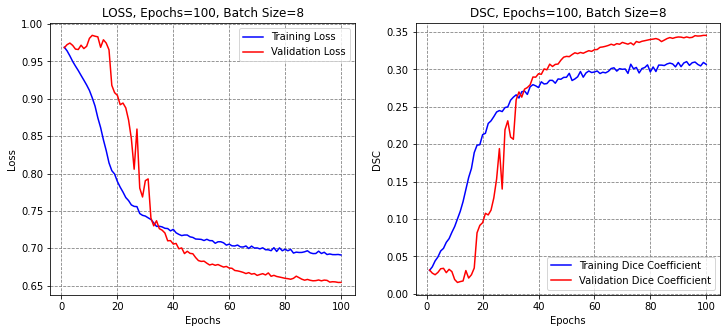

Testing time: 0:00:00.687768
------------------------------
USING THRESHOLD 0.5

 DSC 		0.328 
 IOU 		0.205 
 Recall 	0.899 
 Precision	0.206
 Global Acc 	0.934
 AUC ROC 	0.609


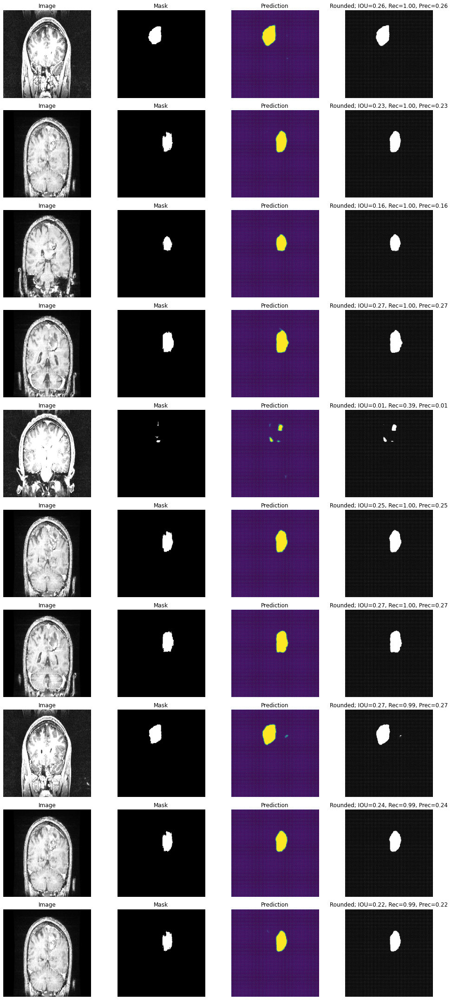

************************************************************

Run # 4
Epoch 1/100
16/16 [==============================] - 7s 135ms/step - loss: 0.9640 - dsc: 0.0358 - dice_coef: 0.0364 - val_loss: 0.9751 - val_dsc: 0.0250 - val_dice_coef: 0.0252
Epoch 2/100
16/16 [==============================] - 1s 77ms/step - loss: 0.9527 - dsc: 0.0477 - dice_coef: 0.0486 - val_loss: 0.9713 - val_dsc: 0.0288 - val_dice_coef: 0.0291
Epoch 3/100
16/16 [==============================] - 1s 71ms/step - loss: 0.9385 - dsc: 0.0608 - dice_coef: 0.0626 - val_loss: 0.9633 - val_dsc: 0.0368 - val_dice_coef: 0.0372
Epoch 4/100
16/16 [==============================] - 1s 73ms/step - loss: 0.9260 - dsc: 0.0729 - dice_coef: 0.0751 - val_loss: 0.9555 - val_dsc: 0.0445 - val_dice_coef: 0.0450
Epoch 5/100
16/16 [==============================] - 1s 71ms/step - loss: 0.9154 - dsc: 0.0821 - dice_coef: 0.0844 - val_loss: 0.9501 - val_dsc: 0.0502 - val_dice_coef: 0.0505
Epoch 6/100
16/16 [==============================

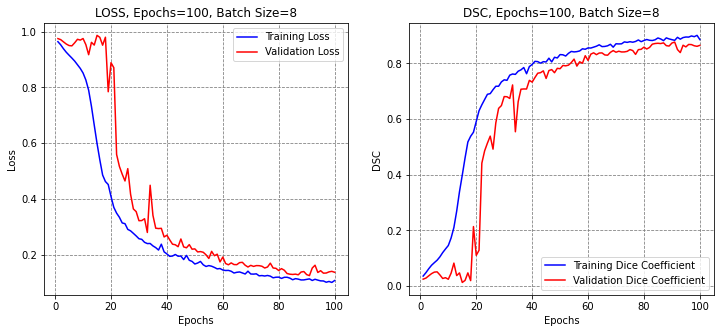

Testing time: 0:00:00.668496
------------------------------
USING THRESHOLD 0.5

 DSC 		0.724 
 IOU 		0.648 
 Recall 	0.784 
 Precision	0.818
 Global Acc 	0.996
 AUC ROC 	0.935


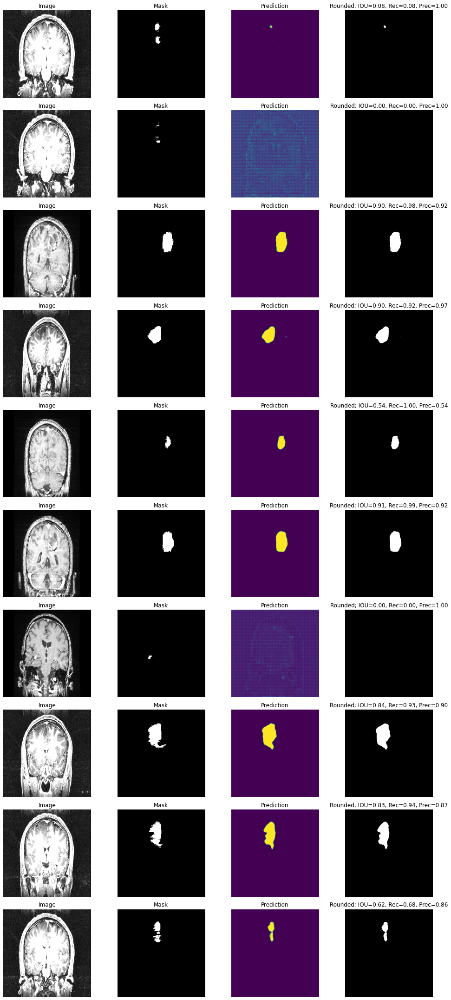

************************************************************

Run # 5
Epoch 1/100
16/16 [==============================] - 8s 217ms/step - loss: 0.9676 - dsc: 0.0325 - dice_coef: 0.0329 - val_loss: 0.9655 - val_dsc: 0.0345 - val_dice_coef: 0.0349
Epoch 2/100
16/16 [==============================] - 1s 75ms/step - loss: 0.9595 - dsc: 0.0404 - dice_coef: 0.0410 - val_loss: 0.9627 - val_dsc: 0.0373 - val_dice_coef: 0.0378
Epoch 3/100
16/16 [==============================] - 1s 78ms/step - loss: 0.9477 - dsc: 0.0524 - dice_coef: 0.0535 - val_loss: 0.9592 - val_dsc: 0.0406 - val_dice_coef: 0.0413
Epoch 4/100
16/16 [==============================] - 1s 74ms/step - loss: 0.9355 - dsc: 0.0634 - dice_coef: 0.0648 - val_loss: 0.9559 - val_dsc: 0.0438 - val_dice_coef: 0.0447
Epoch 5/100
16/16 [==============================] - 1s 76ms/step - loss: 0.9237 - dsc: 0.0741 - dice_coef: 0.0761 - val_loss: 0.9513 - val_dsc: 0.0482 - val_dice_coef: 0.0493
Epoch 6/100
16/16 [==============================

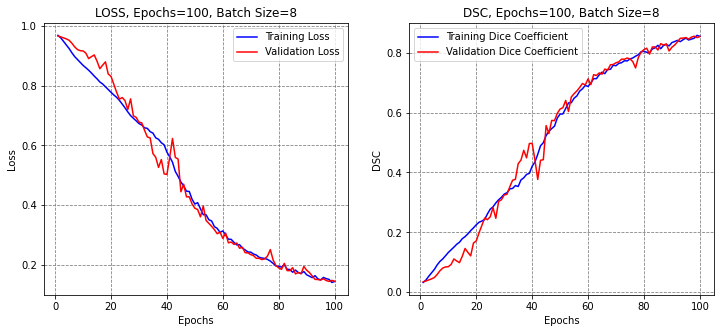

Testing time: 0:00:01.908165
------------------------------
USING THRESHOLD 0.5

 DSC 		0.711 
 IOU 		0.665 
 Recall 	0.712 
 Precision	0.947
 Global Acc 	0.997
 AUC ROC 	0.961


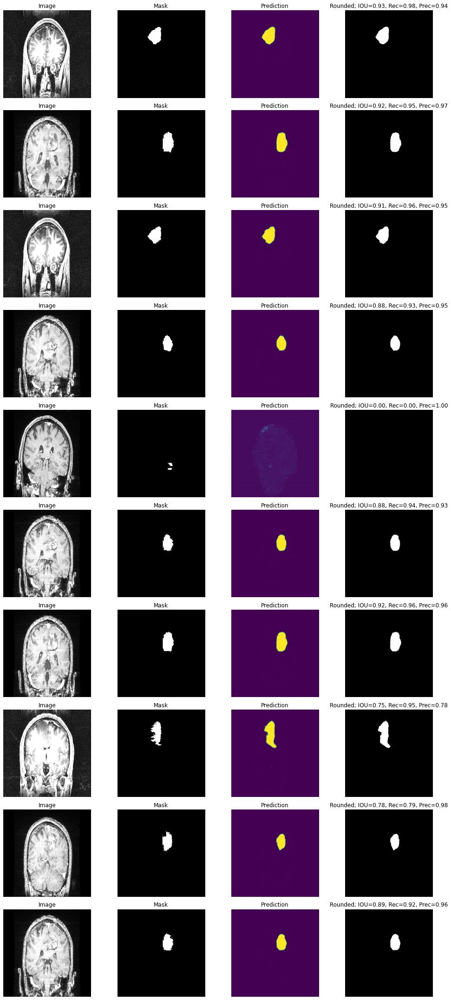

************************************************************


In [ ]:
outputs_df = train_model()

In [ ]:
outputs_df

,Epochs Number,Dice Score,IOU Score,Recall (Sensitivity),Precision,Global Accuracy,AUC-ROC
0,100.0,0.704775,0.649499,0.727648,0.914228,0.996593,0.952185
1,100.0,0.650003,0.588580,0.640033,0.927506,0.997370,0.966284
2,100.0,0.328344,0.205474,0.899187,0.205981,0.934101,0.608620
3,100.0,0.723797,0.648338,0.784102,0.817847,0.996081,0.935456
4,100.0,0.711166,0.664638,0.712436,0.946513,0.996945,0.961230


In [ ]:
outputs_df.mean()

Epochs Number           100.000000
Dice Score                0.697435
IOU Score                 0.637764
Recall (Sensitivity)      0.716055
Precision                 0.901523
Global Accuracy           0.996747
AUC-ROC                   0.953789
dtype: float64

In [ ]:
outputs_df.std()

Epochs Number           0.000000
Dice Score              0.032594
IOU Score               0.033620
Recall (Sensitivity)    0.059322
Precision               0.057336
Global Accuracy         0.000546
AUC-ROC                 0.013542
dtype: float64